In [71]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout,BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.metrics import TopKCategoricalAccuracy
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.utils import plot_model


import visualkeras
from PIL import ImageFont

import shap

from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns


import os
import random
import tensorflow as tf
import numpy as np
import shap
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

Traceback (most recent call last):
  File "c:\users\jarushen\appdata\local\programs\python\python38-32\lib\runpy.py", line 193, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "c:\users\jarushen\appdata\local\programs\python\python38-32\lib\runpy.py", line 86, in _run_code
    exec(code, run_globals)
  File "C:\Users\Jarushen\AppData\Local\Programs\Python\Python38-32\Scripts\jupyter-nbextension.EXE\__main__.py", line 7, in <module>
  File "c:\users\jarushen\appdata\local\programs\python\python38-32\lib\site-packages\jupyter_core\application.py", line 254, in launch_instance
    return super(JupyterApp, cls).launch_instance(argv=argv, **kwargs)
  File "c:\users\jarushen\appdata\local\programs\python\python38-32\lib\site-packages\traitlets\config\application.py", line 845, in launch_instance
    app.start()
  File "c:\users\jarushen\appdata\local\programs\python\python38-32\lib\site-packages\notebook\nbextensions.py", line 988, in start
    super(NBExtensionA

## Data Loading and Initialisation




In [72]:
root_path = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\Fynbos_Dataset_A"  # FLORA Dataset A

In [6]:
top5_acc = TopKCategoricalAccuracy(k=5, name='top5_acc')
top10_acc = TopKCategoricalAccuracy(k=10, name='top10_acc')

In [7]:
# Initialize an image data generator with some data augmentation
datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)

# Load images from directory
train_generator = datagen.flow_from_directory(
    root_path,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

validation_generator = datagen.flow_from_directory(
    root_path,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)




Found 971 images belonging to 35 classes.
Found 225 images belonging to 35 classes.


## CNN Architecture

In [9]:

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPooling2D(2, 2),
    
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    
    Flatten(),
    Dropout(0.5),
    
    Dense(128, activation='relu'),
    Dense(len(train_generator.class_indices), activation='softmax')
])


## Model Compile

In [10]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', top5_acc, top10_acc])

## Train Model

In [11]:
# Train the model
history = model.fit(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)

Epoch 1/50
31/31 [==============================] - 263s 8s/step - loss: 3.5275 - accuracy: 0.0484 - top5_acc: 0.2297 - top10_acc: 0.4119 - val_loss: 3.4363 - val_accuracy: 0.0356 - val_top5_acc: 0.2978 - val_top10_acc: 0.5200
Epoch 2/50
31/31 [==============================] - 273s 9s/step - loss: 3.3057 - accuracy: 0.0968 - top5_acc: 0.3450 - top10_acc: 0.5458 - val_loss: 3.2561 - val_accuracy: 0.1067 - val_top5_acc: 0.3467 - val_top10_acc: 0.5511
Epoch 3/50
31/31 [==============================] - 264s 9s/step - loss: 3.1472 - accuracy: 0.1287 - top5_acc: 0.4192 - top10_acc: 0.6303 - val_loss: 3.2276 - val_accuracy: 0.1244 - val_top5_acc: 0.4044 - val_top10_acc: 0.6133
Epoch 4/50
31/31 [==============================] - 281s 9s/step - loss: 3.0212 - accuracy: 0.1535 - top5_acc: 0.4624 - top10_acc: 0.6797 - val_loss: 3.0810 - val_accuracy: 0.1200 - val_top5_acc: 0.3867 - val_top10_acc: 0.6089
Epoch 5/50
31/31 [==============================] - 290s 9s/step - loss: 2.9149 - accuracy: 

array([ 0,  0,  0,  1,  2,  3,  4,  5,  6,  6,  7,  8,  8,  9,  9, 10, 11,
       11, 12, 12, 13, 15, 15, 16, 16, 16, 16, 16, 17, 17, 18, 19, 19, 19,
       20, 20, 20, 20, 20, 21, 21, 22, 22, 22, 22, 23, 23, 24, 24, 25, 25,
       25, 26, 26, 26, 27, 27, 28, 29, 29, 29, 29, 29, 29, 29, 30, 30, 31,
       31, 31, 32, 33, 34, 34, 34, 34])

In [12]:
val_loss, val_accuracy, *_ = model.evaluate(validation_generator)
print(f"Validation accuracy: {val_accuracy*100:.2f}%")

8/8 [==============================] - 105s 14s/step - loss: 2.7312 - accuracy: 0.3378 - top5_acc: 0.6444 - top10_acc: 0.7822
Validation accuracy: 33.78%


In [13]:
model.save(r"C:\Users\Jarushen\Desktop\Masters Thesis\Code\Models\Baseline_A")

INFO:tensorflow:Assets written to: C:\Users\Jarushen\Desktop\Masters Thesis\Code\Models\Baseline_A\assets


INFO:tensorflow:Assets written to: C:\Users\Jarushen\Desktop\Masters Thesis\Code\Models\Baseline_A\assets


In [10]:
# Path to the saved model
model_path = r"C:\Users\Jarushen\Desktop\Masters Thesis\Code\Models\Baseline_1"

# Load the model
model = tf.keras.models.load_model(model_path)

## Classification Report

In [14]:
validation_generator.reset()
Y_pred = model.predict(validation_generator)
y_pred = np.argmax(Y_pred, axis=1)

8/8 [==============================] - 142s 18s/step


In [132]:
# Generate target_names based on the classes present in the validation generator
target_names = [k for k, v in sorted(validation_generator.class_indices.items(), key=lambda item: item[1])]

# Generate the classification report
print('Classification Report')
print(classification_report(validation_generator.classes, y_pred, target_names=target_names, labels=np.arange(len(target_names))))


Classification Report
                             precision    recall  f1-score   support

      Agathosma serpyllacea       0.00      0.00      0.00         3
           Aloe arborescens       0.25      0.33      0.29         6
    Arctotis stoechadifolia       1.00      0.25      0.40         4
           Aristea capitata       0.50      0.25      0.33         4
     Baloskion tetraphyllum       0.40      0.50      0.44         4
      Carpobrotus chilensis       0.00      0.00      0.00         5
         Carpobrotus edulis       0.00      0.00      0.00         4
       Cotyledon orbiculata       0.25      0.11      0.15         9
           Curio talinoides       0.62      0.62      0.62         8
          Erica arborescens       0.57      0.80      0.67         5
              Erica cinerea       0.00      0.00      0.00         7
             Erica discolor       0.57      0.67      0.62         6
             Erica duthieae       0.00      0.00      0.00         3
           

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


ModuleNotFoundError: No module named 'shap'

## Confusion Matrix

In [129]:
cm = confusion_matrix(validation_generator.classes, y_pred)

In [260]:
# Define a function to print the confusion matrix neatly
def print_confusion_matrix(confusion_matrix, class_names):
    pretty_print = "\t" + "\t".join(class_names) + "\n"
    for i, row in enumerate(confusion_matrix):
        pretty_print += class_names[i] + "\t" + "\t".join(str(cell) for cell in row) + "\n"
    print(pretty_print)

# Assuming 'target_names' contains the list of class names in the order they are encoded
print_confusion_matrix(cm, target_names)



	Agathosma serpyllacea	Aloe arborescens	Arctotis stoechadifolia	Aristea capitata	Baloskion tetraphyllum	Carpobrotus chilensis	Carpobrotus edulis	Cotyledon orbiculata	Curio talinoides	Erica arborescens	Erica cinerea	Erica discolor	Erica duthieae	Erica perspicua	Gazania rigens	Grevillea banksii	Helichrysum petiolare	Leucadendron argenteum	Leucadendron laureolum	Leucadendron salignum	Leucospermum cordifolium	Leucospermum oleifolium	Lithospermum ruderale	Melianthus major	Mutisia orbignyana	Oscularia deltoides	Osyris lanceolata	Ozothamnus leptophyllus	Pelargonium crispum	Protea aurea	Protea cynaroides	Protea neriifolia	Protea repens	Schoenoplectus californicus	Strelitzia reginae
Agathosma serpyllacea	0	2	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	1	0	0	0
Aloe arborescens	0	2	0	0	0	0	0	0	1	0	0	0	1	0	0	0	0	0	0	0	0	0	0	2	0	0	0	0	0	0	0	0	0	0	0
Arctotis stoechadifolia	0	1	0	0	0	0	0	0	2	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	0	1	0	0	0	0	0	0	0
Aristea capitata	0	0	0	2	0	0	1	0	0	0	1	0	0	0

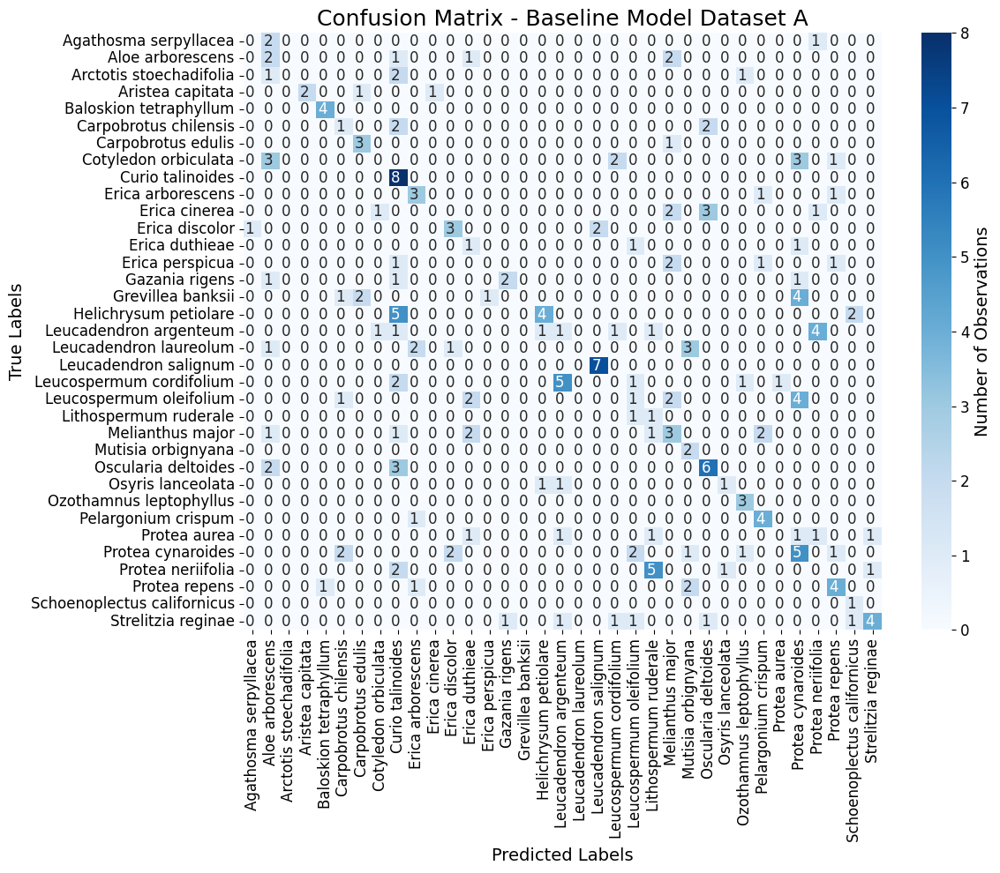

In [265]:
plt.figure(figsize=(12, 10))  # Increased figure size for better readability

# Creating the heatmap
ax = sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', 
                 xticklabels=target_names, yticklabels=target_names)

# Rotate the x-axis labels
plt.xticks(rotation=90)  # Rotate x-axis labels to be vertical
plt.yticks(rotation=0)  # Ensure y-axis labels are horizontal for consistency

# Setting labels and title with increased font size for readability
plt.xlabel('Predicted Labels', fontsize=14)
plt.ylabel('True Labels', fontsize=14)
plt.title('Confusion Matrix - Baseline Model Dataset A', fontsize=18)

# Increasing the font size of the annotations
for t in ax.texts:
    t.set_text(t.get_text() + " ")  # Adding space for better visibility
    t.set_size(12)  # Increase the annotation text size if needed

ax.tick_params(axis='both', which='major', labelsize=12)  # Adjust tick label size

# Adjust color bar label size
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=12)  # Adjust the color bar tick label size
cbar.set_label('Number of Observations', fontsize=14)

plt.tight_layout()  # Adjusts the plot to fit into the figure area.

# Save the figure with a higher resolution
plt.savefig(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Results\confusion_matrix_Baseline_A.png",
            format='png', dpi=400, bbox_inches='tight')  # Increased DPI for higher resolution

# Show the plot
plt.show()



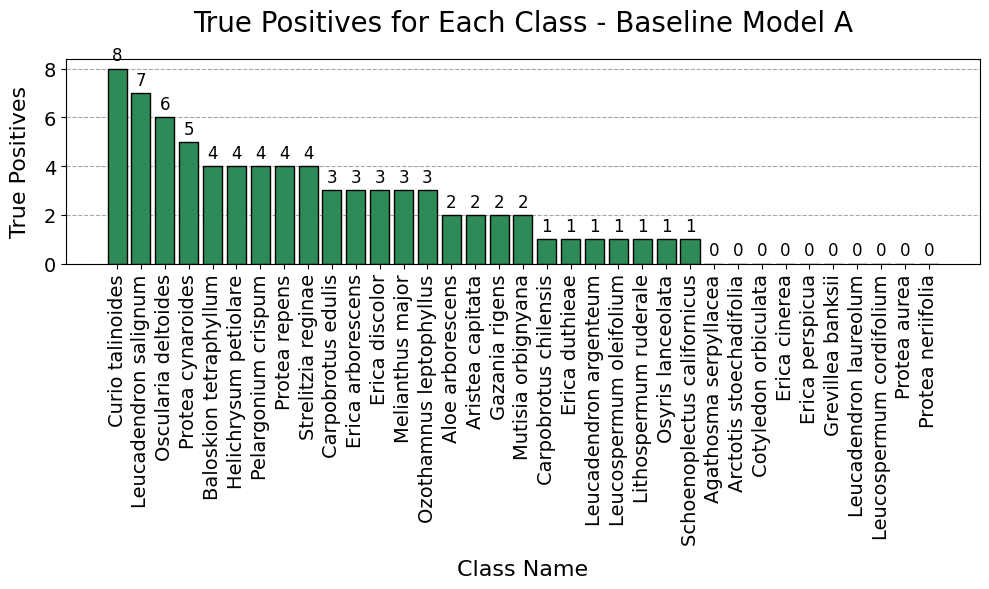

In [264]:
import matplotlib.pyplot as plt
import numpy as np



# Extract true positives from the confusion matrix
true_positives = np.diag(cm)

# Pair each class name with its corresponding true positive count and sort
sorted_pairs = sorted(zip(target_names, true_positives), key=lambda x: x[1], reverse=True)

# Unzip the sorted pairs
sorted_target_names, sorted_true_positives = zip(*sorted_pairs)

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))  # Set figure size

# Create bar plot with sorted data
bars = ax.bar(sorted_target_names, sorted_true_positives, color='seagreen', edgecolor='black')

# Add labels and title
ax.set_xlabel('Class Name', fontsize=16, labelpad=10)
ax.set_ylabel('True Positives', fontsize=16, labelpad=10)
ax.set_title('True Positives for Each Class - Baseline Model A', fontsize=20, pad=20)

plt.xticks(rotation=90, fontsize=14)  # Labels are now horizontal
plt.yticks(fontsize=14)

# Add data labels
for bar in bars:
    height = bar.get_height()
    ax.annotate(f'{height}',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom', fontsize=12)

# Add grid lines behind the bars for better readability of the y-values
ax.set_axisbelow(True)
ax.yaxis.grid(color='gray', linestyle='dashed', alpha=0.7)

# Tight layout to ensure everything fits without overlapping
plt.tight_layout()

plt.savefig(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Results\Baseline_A_true_positives_bar_graph.png", format='png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

<Figure size 640x480 with 0 Axes>

## Accuracy

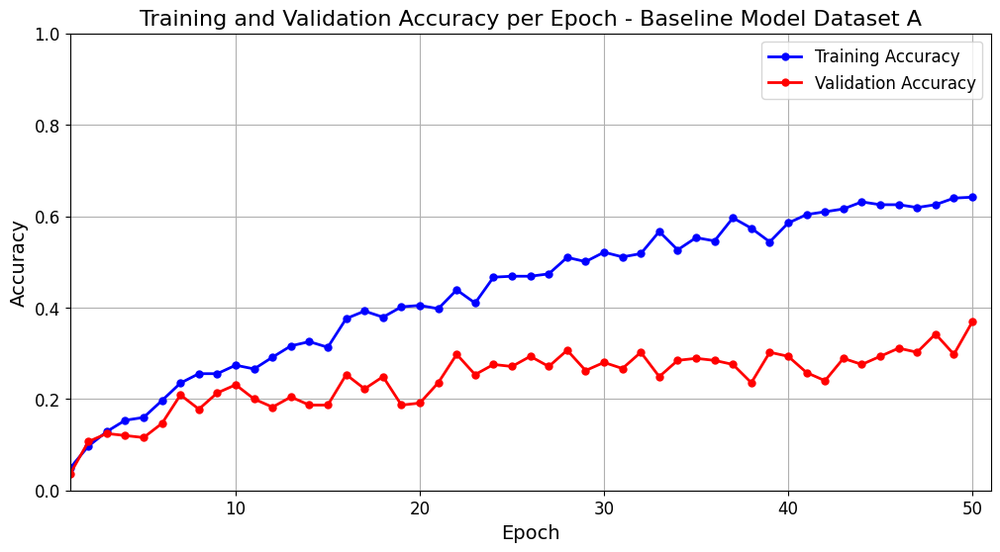

In [251]:
import matplotlib.pyplot as plt

# Assuming 'history' is the object returned by the model.fit() method
epochs = range(1, len(history.history['accuracy']) + 1)

plt.figure(figsize=(12, 6))

# Increase line thickness and marker size
plt.plot(epochs, history.history['accuracy'], 'bo-', label='Training Accuracy', linewidth=2, markersize=5)
plt.plot(epochs, history.history['val_accuracy'], 'ro-', label='Validation Accuracy', linewidth=2, markersize=5)

# Title and labels with increased font size
plt.title('Training and Validation Accuracy per Epoch - Baseline Model Dataset A', fontsize=16)
plt.xlabel('Epoch', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)

# Set fixed axes limits
plt.ylim([0, 1])
plt.xlim([1, 51])

# Enhanced tick labels
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Add gridlines
plt.grid(True)

# Increase legend font size
plt.legend(fontsize=12)

# Save the figure in high resolution
plt.savefig(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Results\Epoch_A.png", format='png', dpi=300)

plt.show()



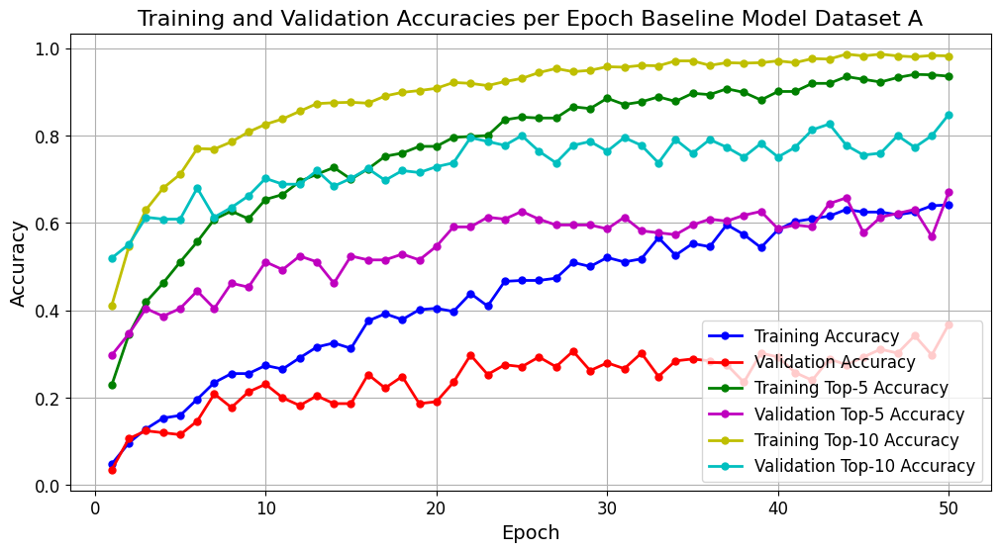

In [253]:
import matplotlib.pyplot as plt

# Assuming 'history' contains 'accuracy', 'val_accuracy', 'top5_accuracy', 'val_top5_accuracy', 'top10_accuracy', 'val_top10_accuracy'
epochs = range(1, len(history.history['accuracy']) + 1)

plt.figure(figsize=(12, 6))

# Standard accuracy with increased line thickness and marker size
plt.plot(epochs, history.history['accuracy'], 'bo-', label='Training Accuracy', linewidth=2, markersize=5)
plt.plot(epochs, history.history['val_accuracy'], 'ro-', label='Validation Accuracy', linewidth=2, markersize=5)

# Top-5 accuracy with increased line thickness and marker size
plt.plot(epochs, history.history['top5_acc'], 'go-', label='Training Top-5 Accuracy', linewidth=2, markersize=5)
plt.plot(epochs, history.history['val_top5_acc'], 'mo-', label='Validation Top-5 Accuracy', linewidth=2, markersize=5)

# Top-10 accuracy with increased line thickness and marker size
plt.plot(epochs, history.history['top10_acc'], 'yo-', label='Training Top-10 Accuracy', linewidth=2, markersize=5)
plt.plot(epochs, history.history['val_top10_acc'], 'co-', label='Validation Top-10 Accuracy', linewidth=2, markersize=5)

# Title and labels with increased font size
plt.title('Training and Validation Accuracies per Epoch Baseline Model Dataset A', fontsize=16)
plt.xlabel('Epoch', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)

# Enhanced tick labels
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Add gridlines
plt.grid(True)

# Increase legend font size
plt.legend(fontsize=12)

# Save the figure in high resolution
plt.savefig(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Results\t5t10_A_Baseline.png", format='png', dpi=300)

# Show the plot
plt.show()


## Loss

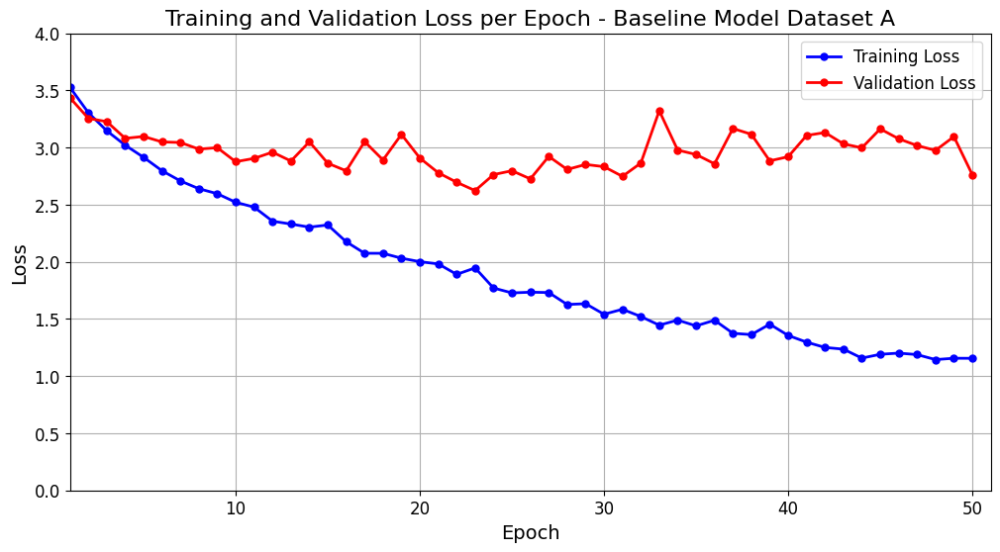

In [254]:
import matplotlib.pyplot as plt

# Replace 'loss' and 'val_loss' with the actual keys if they are different
epochs = range(1, len(history.history['loss']) + 1)

plt.figure(figsize=(12, 6))

# Plot training and validation loss with increased line thickness and marker size
plt.plot(epochs, history.history['loss'], 'bo-', label='Training Loss', linewidth=2, markersize=5)
plt.plot(epochs, history.history['val_loss'], 'ro-', label='Validation Loss', linewidth=2, markersize=5)

# Title and labels with increased font size
plt.title('Training and Validation Loss per Epoch - Baseline Model Dataset A', fontsize=16)
plt.xlabel('Epoch', fontsize=14)
plt.ylabel('Loss', fontsize=14)

# Enhanced tick labels
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Add gridlines
plt.grid(True)

# Increase legend font size
plt.legend(fontsize=12)

# Set fixed axes limits
plt.ylim([0, 4])
plt.xlim([1, 51])

# Save the plot in high resolution
plt.savefig(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Results\epoch_A_Loss.png", format='png', dpi=300)

# Show the plot
plt.show()


## Layer Visualisation

In [85]:

# Assuming 'model' is your Sequential model

# If you want to use a custom font, specify the path to a .ttf file (optional)
# For example, using Arial font in Windows. Replace 'arial.ttf' with the full path to the font file if needed
# font = ImageFont.truetype("arial.ttf", 12)

# Specify custom colors for different layers (optional)
color_map = {
    'Conv2D': 'skyblue', 
    'MaxPooling2D': 'tomato', 
    'Dense': 'orange', 
    'Dropout': 'lightgreen', 
    'Flatten': 'teal'
    # Add more layers and colors as needed
}

# Create a layered view with custom settings
layered_view = visualkeras.layered_view(model, legend=True, color_map=color_map, to_file='model_visualization.png') 
# Remove 'to_file' parameter if you don't want to save it yet

# Save the visualization as a high-quality image
layered_view.save(r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Methodology\model_visualization_labeled.png", dpi=300) # dpi can be adjusted for higher resolution

AttributeError: 'ImageFont' object has no attribute 'getsize'

In [92]:
plot_model(model, to_file=r"C:\Users\Jarushen\Desktop\Masters Thesis\Report_Final\images\Methodology\visualisation", show_shapes=True, show_layer_names=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


## SHAP Analysis

In [249]:
# Make sure your model is loaded and validation_generator is defined

# Get filenames and true labels
filenames = validation_generator.filenames
true_labels = validation_generator.classes

# Predict classes
predictions = model.predict(validation_generator)
predicted_classes = np.argmax(predictions, axis=1)

# Compare and record misclassifications
misclassified = []
for i in range(len(filenames)):
    if predicted_classes[i] != true_labels[i]:
        misclassified.append((filenames[i], predicted_classes[i]))

# Now, misclassified contains tuples of (filename, wrong_predicted_class)


8/8 [==============================] - 332s 39s/step


In [183]:
explainer = shap.DeepExplainer(model, images)

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


In [184]:
shap_values = explainer.shap_values(images)

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


In [245]:
shap_values

[array([[[[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]],
 
         [[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]],
 
         [[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]],
 
         ...,
 
         [[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]],
 
         [[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]],
 
         [[0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.],
          ...,
          [0., 0., 0.],
          [0., 0., 0.],
          [0., 0., 0.]]]]),
 array([[[[

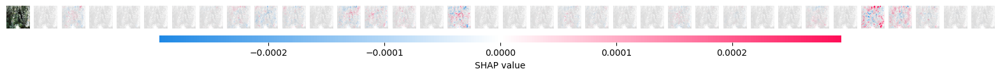

<Figure size 1000x1000 with 0 Axes>

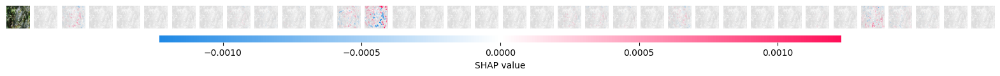

<Figure size 1000x1000 with 0 Axes>

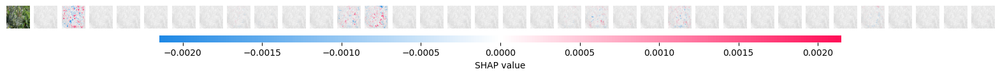

<Figure size 1000x1000 with 0 Axes>

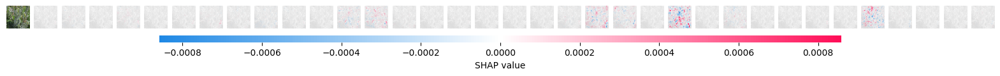

<Figure size 1000x1000 with 0 Axes>

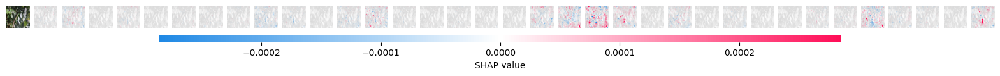

<Figure size 1000x1000 with 0 Axes>

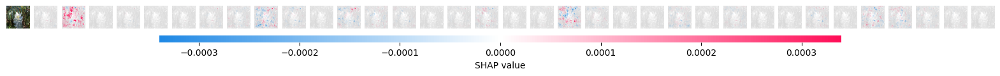

<Figure size 1000x1000 with 0 Axes>

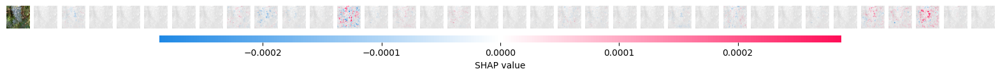

<Figure size 1000x1000 with 0 Axes>

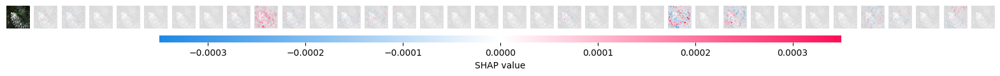

<Figure size 1000x1000 with 0 Axes>

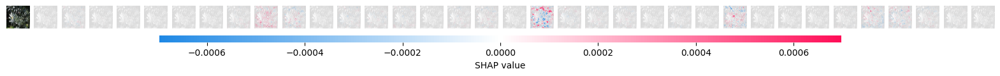

<Figure size 1000x1000 with 0 Axes>

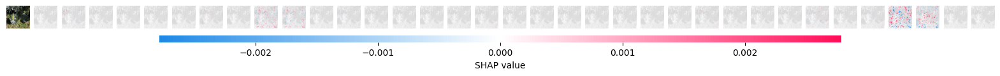

<Figure size 1000x1000 with 0 Axes>

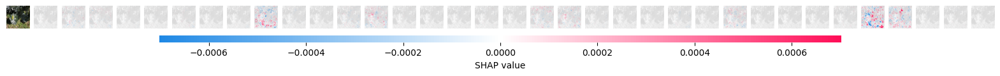

<Figure size 1000x1000 with 0 Axes>

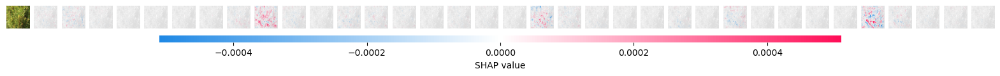

<Figure size 1000x1000 with 0 Axes>

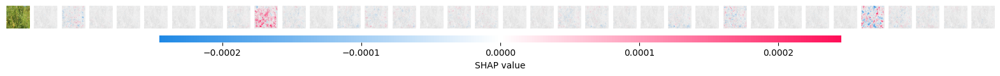

<Figure size 1000x1000 with 0 Axes>

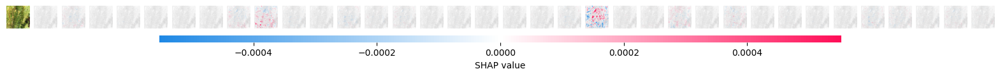

<Figure size 1000x1000 with 0 Axes>

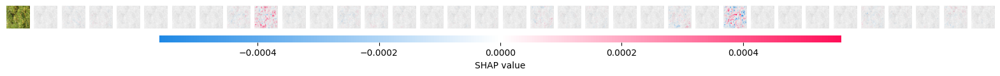

<Figure size 1000x1000 with 0 Axes>

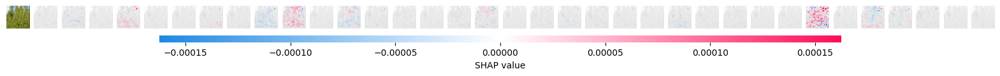

<Figure size 1000x1000 with 0 Axes>

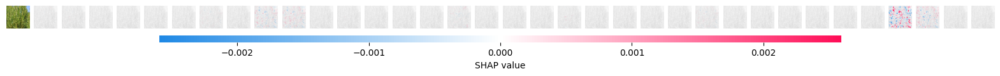

<Figure size 1000x1000 with 0 Axes>

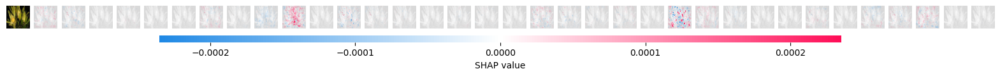

<Figure size 1000x1000 with 0 Axes>

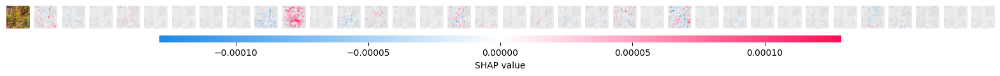

<Figure size 1000x1000 with 0 Axes>

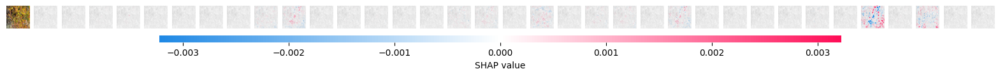

<Figure size 1000x1000 with 0 Axes>

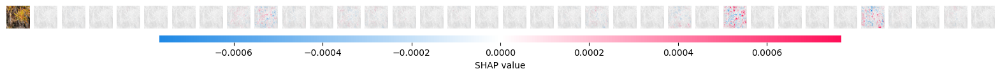

<Figure size 1000x1000 with 0 Axes>

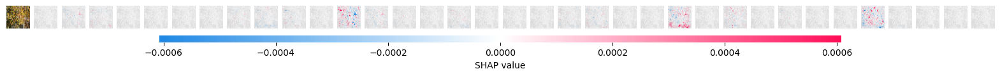

<Figure size 1000x1000 with 0 Axes>

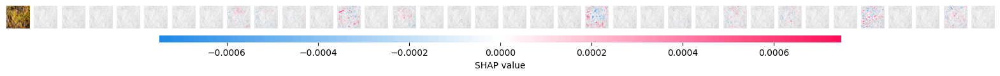

<Figure size 1000x1000 with 0 Axes>

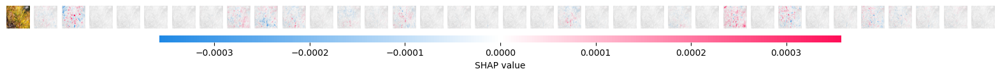

<Figure size 1000x1000 with 0 Axes>

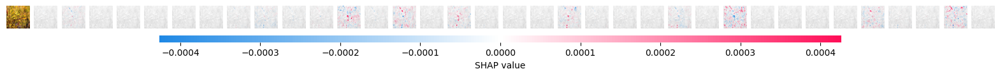

<Figure size 1000x1000 with 0 Axes>

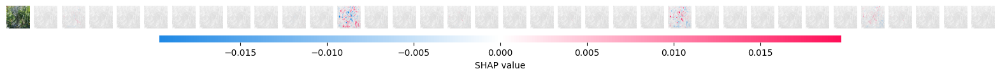

<Figure size 1000x1000 with 0 Axes>

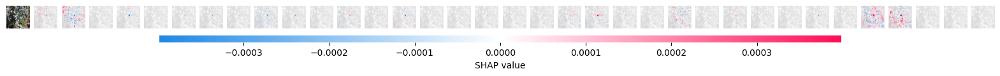

<Figure size 1000x1000 with 0 Axes>

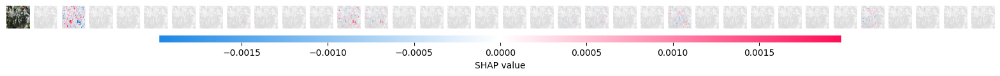

<Figure size 1000x1000 with 0 Axes>

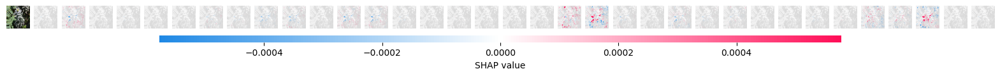

<Figure size 1000x1000 with 0 Axes>

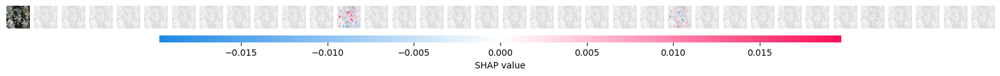

<Figure size 1000x1000 with 0 Axes>

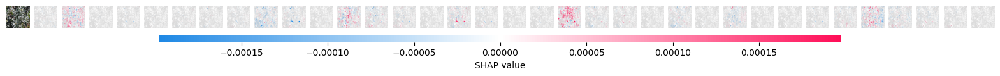

<Figure size 1000x1000 with 0 Axes>

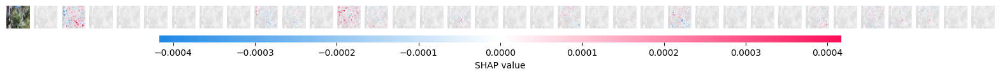

<Figure size 1000x1000 with 0 Axes>

1/1 [==============================] - 1s 692ms/step


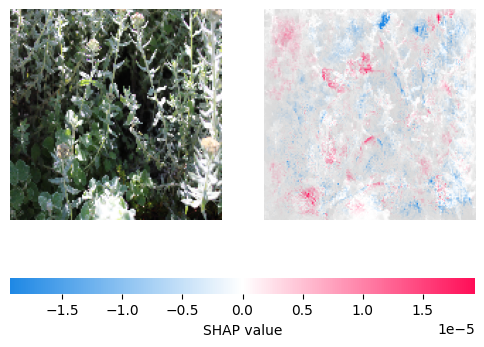

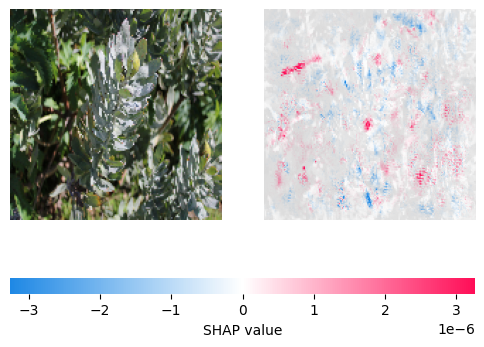

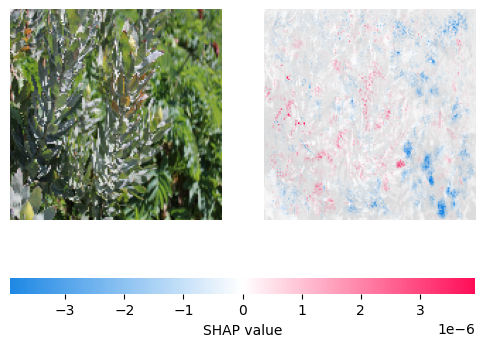

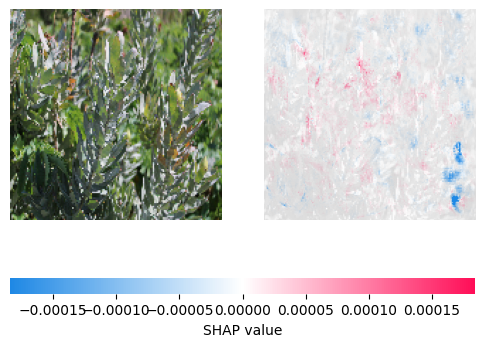

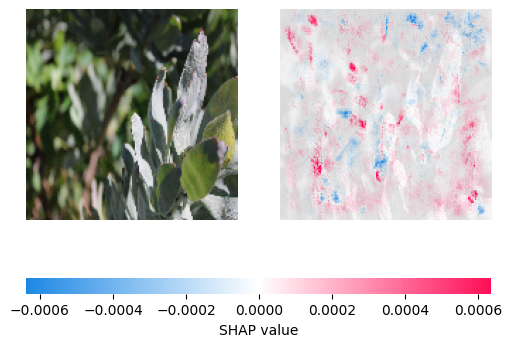

...

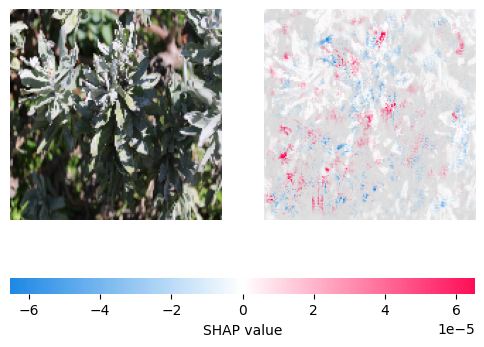

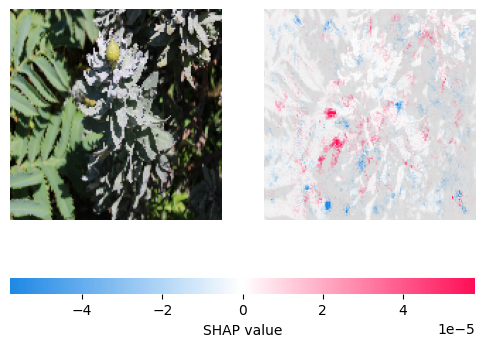

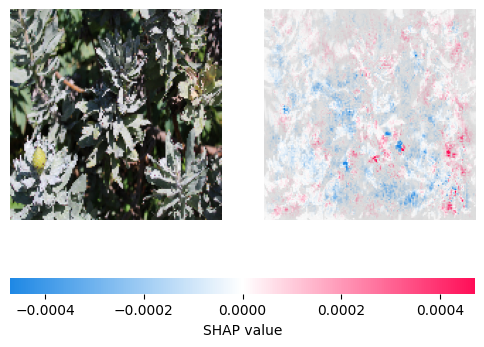

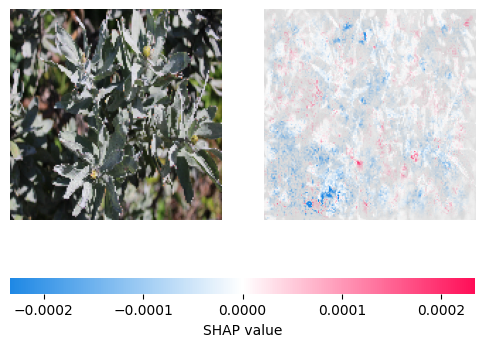

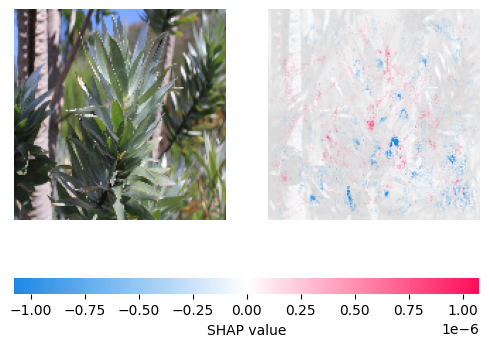

In [218]:
import numpy as np

# Assume `model` is your trained model and `images` is your batch of images.
# Get the predictions for the images
predictions = model.predict(images)

# Determine the class with the highest probability for each image
predicted_classes = np.argmax(predictions, axis=1)

# Calculate SHAP values here as needed before plotting...

# Plot SHAP values for the predicted class of each image
for i, image in enumerate(images):
    # Get the SHAP values for the predicted class
    shap_values_for_predicted_class = shap_values[predicted_classes[i]][i]

    # Plot using SHAP's function
    shap.image_plot(shap_values_for_predicted_class, image)

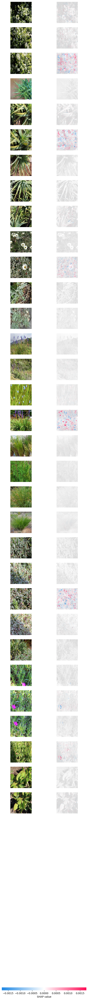

In [118]:
# Select the SHAP values for the first class
shap_values_for_first_class = shap_values[0]

# Visualize the SHAP values for the first image for the first class
shap.image_plot(shap_values_for_first_class, images[0:50])


AttributeError: 'DirectoryIterator' object has no attribute 'shape'

In [174]:
import shap
import numpy as np
import matplotlib.pyplot as plt
import os

# Assume `model` and `validation_generator` are already defined and loaded
# model = ...
# validation_generator = ...

# Create an explainer with a representative background dataset from the validation generator
background = next(validation_generator)[0]
explainer = shap.DeepExplainer(model, background)

# Get the class labels from the validation generator
class_labels = list(validation_generator.class_indices.keys())

# Directory where you want to save the plots
output_directory = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\SHAP_Results\Baseline A"
os.makedirs(output_directory, exist_ok=True)

# Calculate SHAP values for all images in the validation set
shap_values = explainer.shap_values(validation_generator)

# Loop through all images in the validation generator
for i, (images, labels) in enumerate(validation_generator):
    # Loop through each image in the batch
    for j in range(len(images)):
        # Plot SHAP values for each class for the image
        for k, shap_value in enumerate(shap_values):
            # The current label name
            label_name = class_labels[k]
            
            # Create a figure for the SHAP plot
            fig, ax = plt.subplots()
            
            # Plot the SHAP values for the current class
            shap.image_plot(shap_value[i * len(images) + j:i * len(images) + j + 1], images[j:j+1], show=False)
            
            # Add the class label to the plot
            ax.set_title(f"Class: {label_name}")
            
            # Save the plot to the output directory
            plt.savefig(os.path.join(output_directory, f"shap_plot_class_{label_name}_img_{i*len(images)+j}.png"))
            
            # Close the plot to free up memory
            plt.close(fig)
    



AttributeError: 'DirectoryIterator' object has no attribute 'shape'

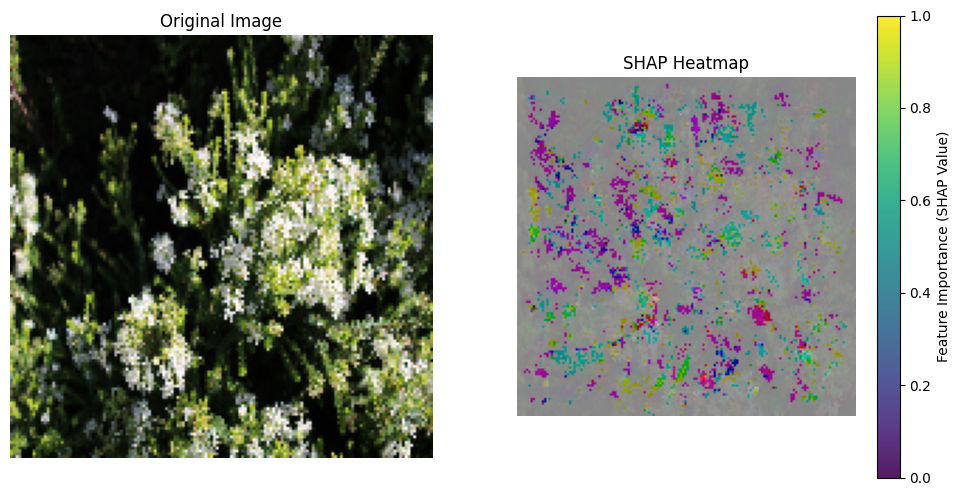

In [117]:
import matplotlib.pyplot as plt
import numpy as np

# Normalize SHAP values to [0, 1] range
shap_values_for_class = shap_values[class_index][2]
shap_min = shap_values_for_class.min()
shap_max = shap_values_for_class.max()
shap_scaled = (shap_values_for_class - shap_min) / (shap_max - shap_min)

# Create a mask for the SHAP values that exceed a certain threshold
# This helps in making the important areas stand out more
mask = shap_scaled > 0.5  # You can adjust this threshold
shap_masked = np.zeros(shap_scaled.shape)
shap_masked[mask] = shap_scaled[mask]

# Now, let's plot the original image and the distinctive SHAP heatmap
plt.figure(figsize=(12, 6))

# Original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.axis('off')
plt.title('Original Image')

# SHAP heatmap
plt.subplot(1, 2, 2)
plt.imshow(original_image, alpha=0.6)  # Slightly transparent original
plt.imshow(shap_masked, cmap='viridis', alpha=0.9)  # Distinctive SHAP heatmap
plt.axis('off')
plt.title('SHAP Heatmap')
plt.colorbar(label='Feature Importance (SHAP Value)')

plt.show()


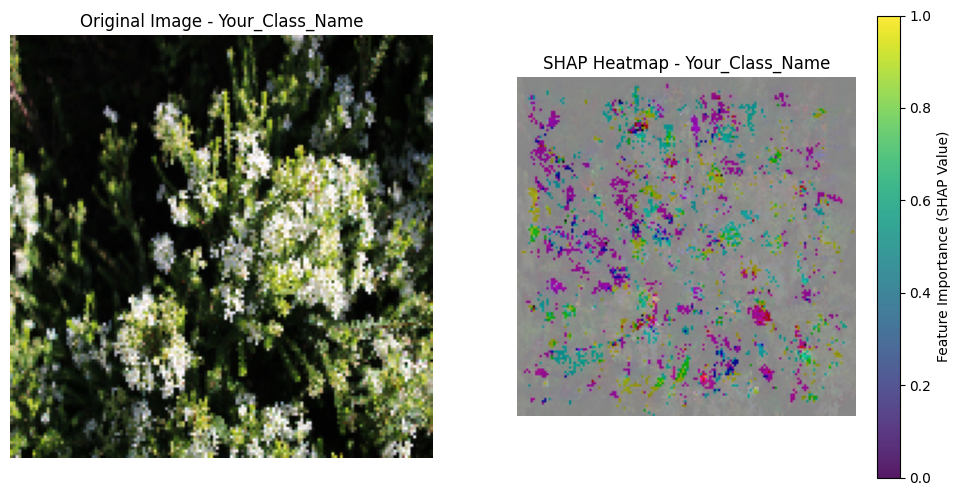

In [146]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming these are provided earlier in your code
# shap_values = ... (your SHAP values array)
# class_index = ... (the index of the class you are interested in)
# original_image = ... (the original image you want to display)

# Normalize SHAP values to [0, 1] range
shap_values_for_class = shap_values[class_index][2]
shap_min = shap_values_for_class.min()
shap_max = shap_values_for_class.max()
shap_scaled = (shap_values_for_class - shap_min) / (shap_max - shap_min)

# Create a mask for the SHAP values that exceed a certain threshold
mask = shap_scaled > 0.5  # You can adjust this threshold
shap_masked = np.zeros(shap_scaled.shape)
shap_masked[mask] = shap_scaled[mask]

# Assuming class_name is a variable holding the name of the class
class_name = "Your_Class_Name"  # Replace with your actual class name

# Plotting the original image and the distinctive SHAP heatmap
plt.figure(figsize=(12, 6))

# Original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.axis('off')
plt.title(f'Original Image - {class_name}')

# SHAP heatmap
plt.subplot(1, 2, 2)
plt.imshow(original_image, alpha=0.6)  # Slightly transparent original
plt.imshow(shap_masked, cmap='viridis', alpha=0.9)  # Distinctive SHAP heatmap
plt.axis('off')
plt.title(f'SHAP Heatmap - {class_name}')
plt.colorbar(label='Feature Importance (SHAP Value)')

plt.show()


Found 225 images belonging to 35 classes.


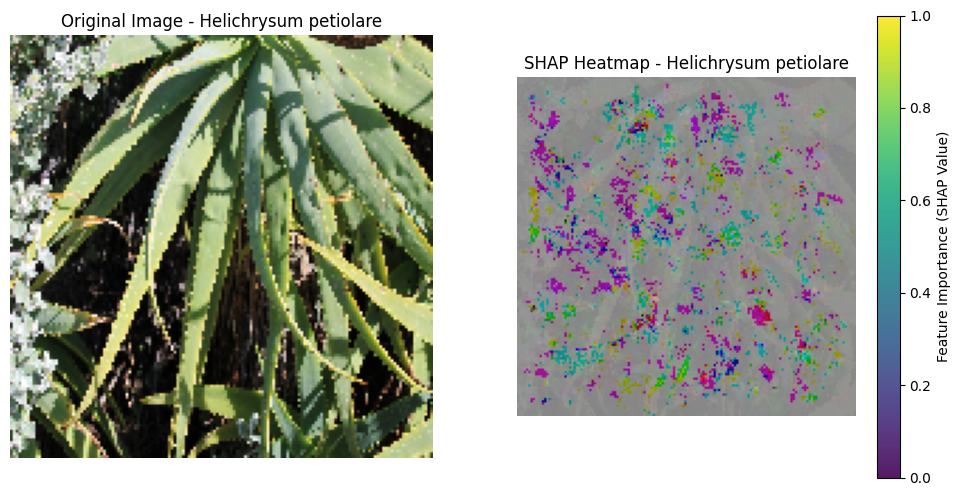

In [163]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Your existing code for loading data
root_path = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\Fynbos_Dataset_A"
datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)
validation_generator = datagen.flow_from_directory(
    root_path,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)

# Get a batch of images
images, labels = next(validation_generator)

# Getting class indices
class_indices = validation_generator.class_indices
index_class = {v: k for k, v in class_indices.items()}

# Assuming these are provided earlier in your code
# shap_values = ... (your SHAP values array)
# class_index = ... (the index of the class you are interested in)
# original_image = ... (the original image you want to display)

# Normalize SHAP values to [0, 1] range
shap_values_for_class = shap_values[class_index][2]
shap_min = shap_values_for_class.min()
shap_max = shap_values_for_class.max()
shap_scaled = (shap_values_for_class - shap_min) / (shap_max - shap_min)

# Create a mask for the SHAP values that exceed a certain threshold
mask = shap_scaled > 0.5  # You can adjust this threshold
shap_masked = np.zeros(shap_scaled.shape)
shap_masked[mask] = shap_scaled[mask]

# Get the class name for the current index
class_name = index_class[class_index]

# Plotting the original image and the distinctive SHAP heatmap
plt.figure(figsize=(12, 6))

# Original image
plt.subplot(1, 2, 1)
plt.imshow(images[7])  # Assuming you want to display the first image in the batch
plt.axis('off')
plt.title(f'Original Image - {class_name}')

# SHAP heatmap
plt.subplot(1, 2, 2)
plt.imshow(images[7], alpha=0.6)  # Slightly transparent original
plt.imshow(shap_masked, cmap='viridis', alpha=0.9)  # Distinctive SHAP heatmap
plt.axis('off')
plt.title(f'SHAP Heatmap - {class_name}')
plt.colorbar(label='Feature Importance (SHAP Value)')

plt.show()




KeyboardInterrupt: 

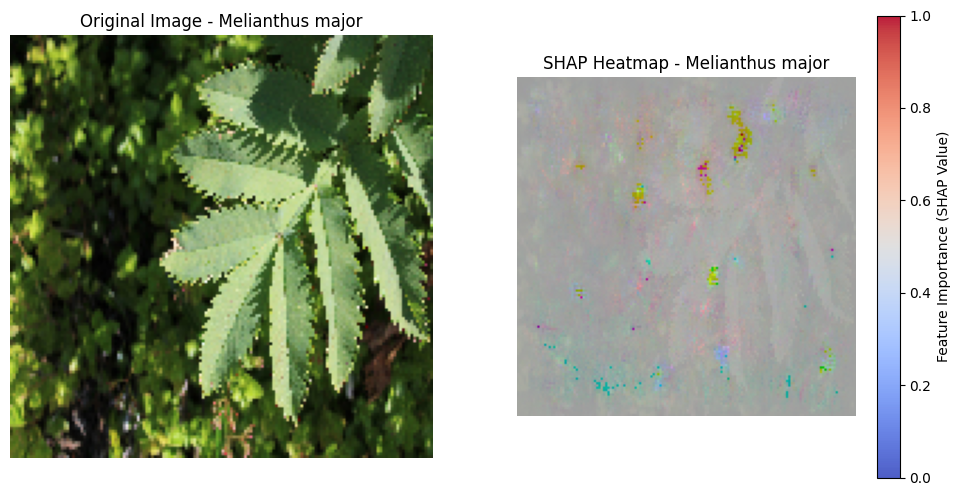

In [168]:
import os
import matplotlib.pyplot as plt
import numpy as np
import shap  # Ensure SHAP is imported for its color map

# Directory to save the plots
save_dir = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\SHAP_Results\Baseline A"
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

# A dictionary to keep track of how many images have been saved per class
image_count_per_class = {}

# Loop over each batch of images
for batch_index in range(len(validation_generator)):
    # Retrieve images and labels for the current batch
    images, labels = next(validation_generator)

    # Loop over each image in the batch
    for i in range(len(images)):
        # Retrieve the corresponding SHAP values for the image
        # This part needs to be adapted based on how you compute or store SHAP values
        shap_values_for_image = shap_values[batch_index][i]  # Modify this line as needed

        # Normalize SHAP values
        shap_min = shap_values_for_image.min()
        shap_max = shap_values_for_image.max()
        shap_scaled = (shap_values_for_image - shap_min) / (shap_max - shap_min)

        # Create a mask
        mask = shap_scaled > 0.5
        shap_masked = np.zeros(shap_scaled.shape)
        shap_masked[mask] = shap_scaled[mask]

        # Determine the class name
        class_index = np.argmax(labels[i])
        class_name = index_class[class_index]

        # Update the count for this class
        image_count_per_class.setdefault(class_name, 0)
        image_count_per_class[class_name] += 1

        # Plotting
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(images[i])
        plt.axis('off')
        plt.title(f'Original Image - {class_name}')

        plt.subplot(1, 2, 2)
        plt.imshow(images[i], alpha=0.6)
        plt.imshow(shap_masked, cmap='coolwarm', alpha=0.9)  # Use the 'coolwarm' colormap
        plt.axis('off')
        plt.title(f'SHAP Heatmap - {class_name}')
        plt.colorbar(label='Feature Importance (SHAP Value)')

        # Save the plot
        image_filename = f'{class_name}_{image_count_per_class[class_name]}.png'
        plt.savefig(os.path.join(save_dir, image_filename))
        plt.close()  # Close the figure to free memory

# Notify when all batches are processed
print("All images processed and saved.")


KeyboardInterrupt: 

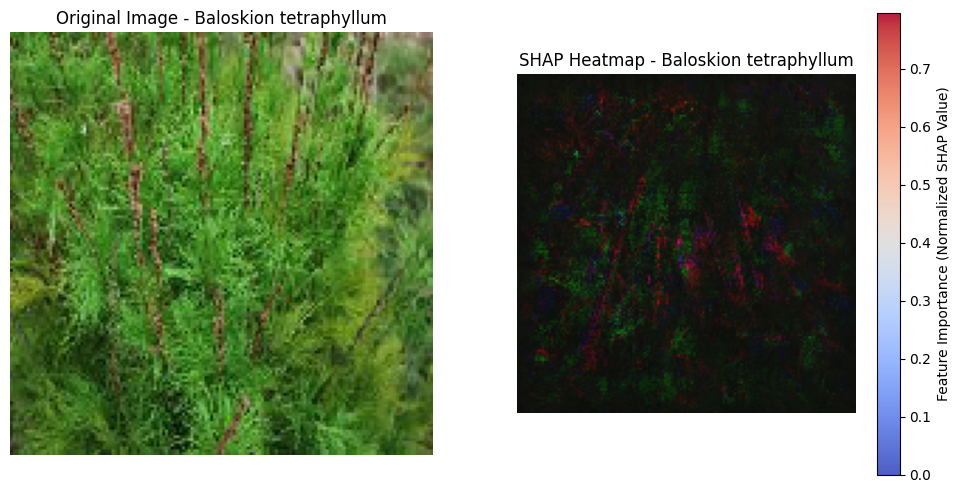

In [167]:
import os
import matplotlib.pyplot as plt
import numpy as np

# Directory to save the plots
save_dir = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\SHAP_Results\Baseline A"
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

# A dictionary to keep track of how many images have been saved per class
image_count_per_class = {}

# Loop over each batch of images
for batch_index in range(len(validation_generator)):
    # Retrieve images and labels for the current batch
    images, labels = next(validation_generator)

    # Loop over each image in the batch
    for i in range(len(images)):
        # Retrieve the corresponding SHAP values for the image
        shap_values_for_image = shap_values[batch_index][i]  # Modify this line as needed

        # Normalize SHAP values to the range [-1, 1]
        shap_max = np.abs(shap_values_for_image).max()
        shap_normalized = shap_values_for_image / shap_max

        # Determine the class name
        class_index = np.argmax(labels[i])
        class_name = index_class[class_index]

        # Update the count for this class
        image_count_per_class.setdefault(class_name, 0)
        image_count_per_class[class_name] += 1

        # Plotting
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(images[i])
        plt.axis('off')
        plt.title(f'Original Image - {class_name}')

        plt.subplot(1, 2, 2)
        plt.imshow(images[i], alpha=0.6)
        plt.imshow(shap_normalized, cmap='coolwarm', alpha=0.9)
        plt.axis('off')
        plt.title(f'SHAP Heatmap - {class_name}')
        plt.colorbar(label='Feature Importance (Normalized SHAP Value)')

        # Save the plot
        image_filename = f'{class_name}_{image_count_per_class[class_name]}.png'
        plt.savefig(os.path.join(save_dir, image_filename))
        plt.close()  # Close the figure to free memory

# Notify when all batches are processed
print("All images processed and saved.")


1/1 [==============================] - 1s 554ms/step


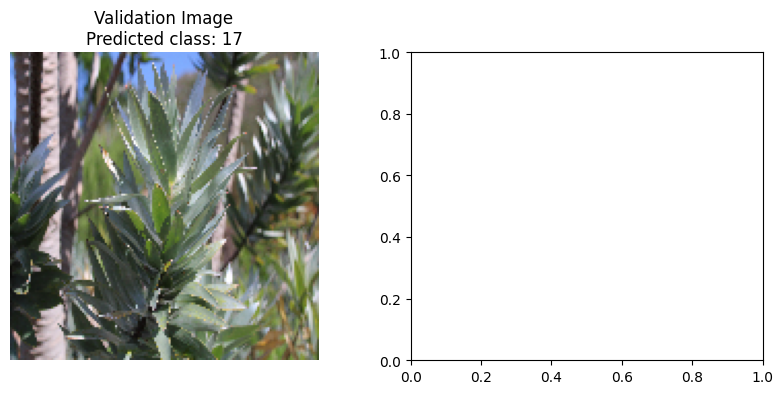

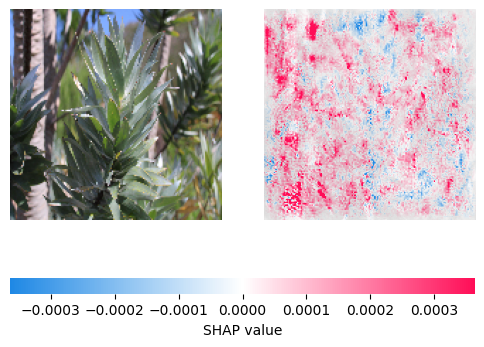

1/1 [==============================] - 0s 47ms/step


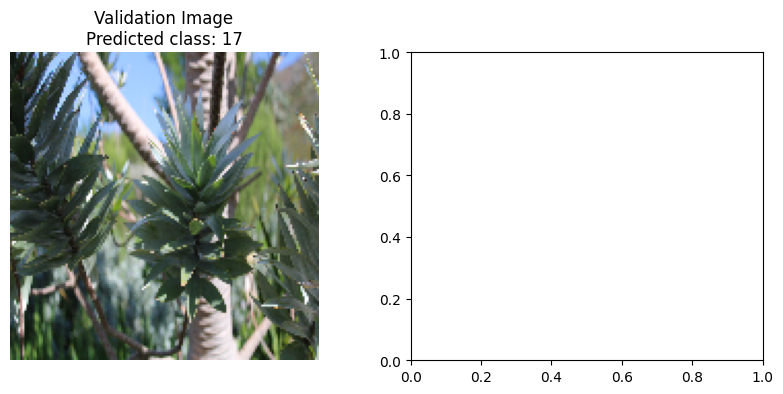

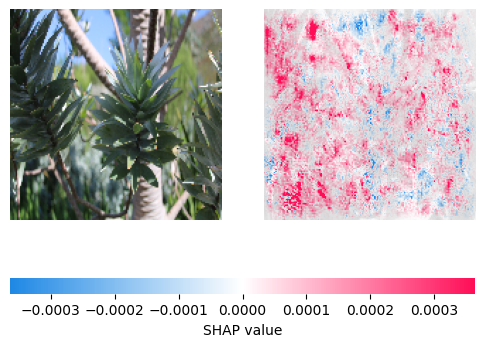

1/1 [==============================] - 0s 47ms/step


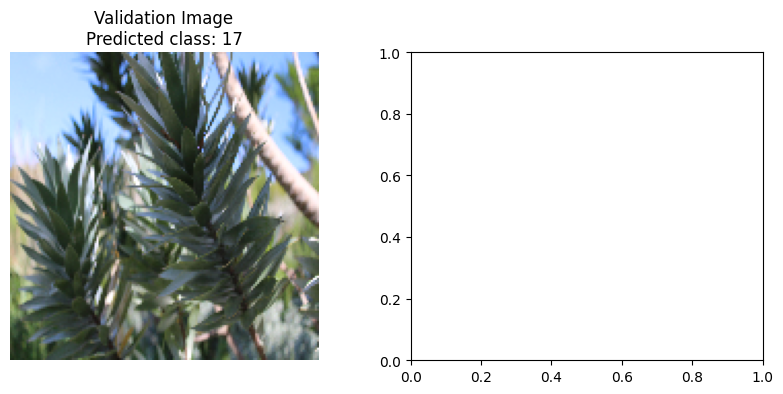

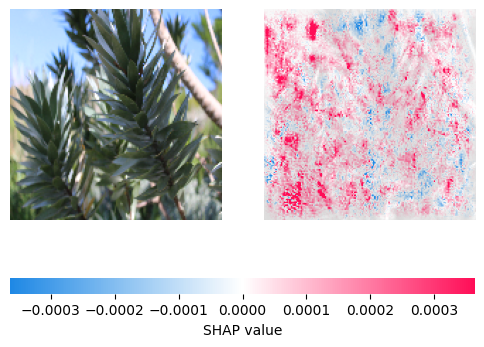

1/1 [==============================] - 0s 54ms/step


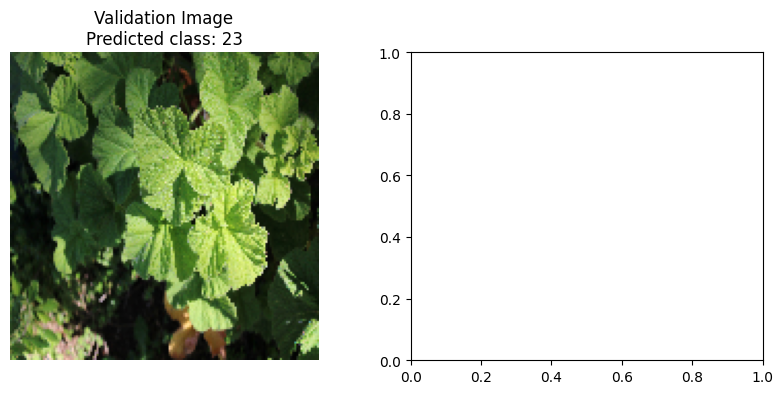

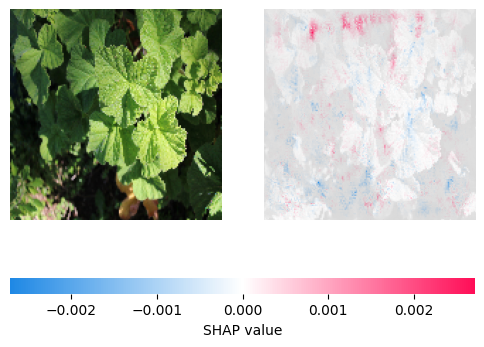

1/1 [==============================] - 0s 47ms/step


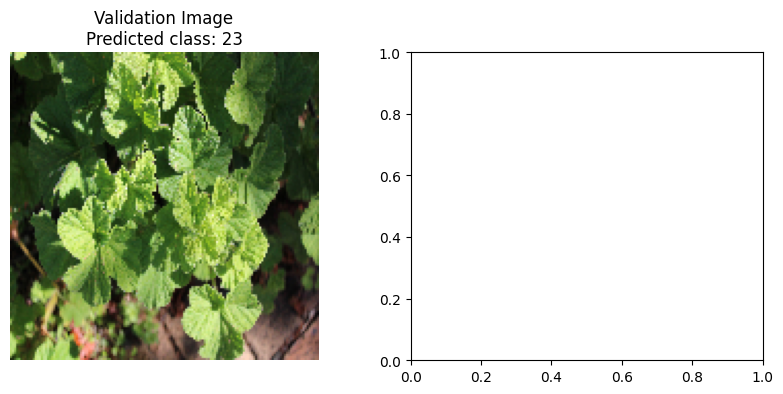

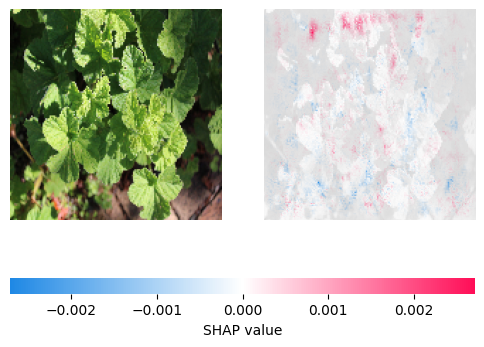

1/1 [==============================] - 0s 31ms/step


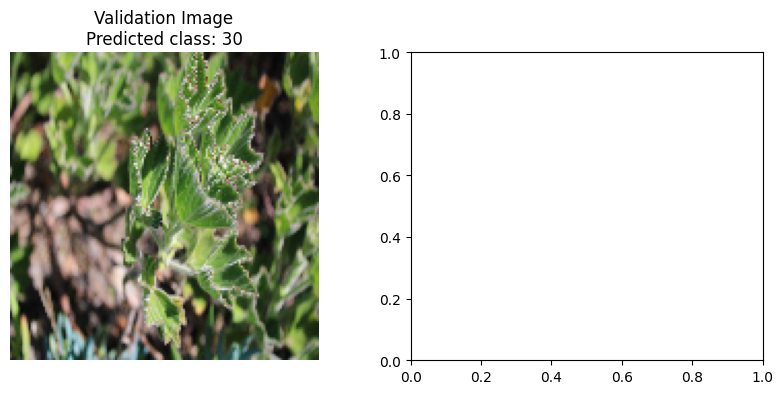

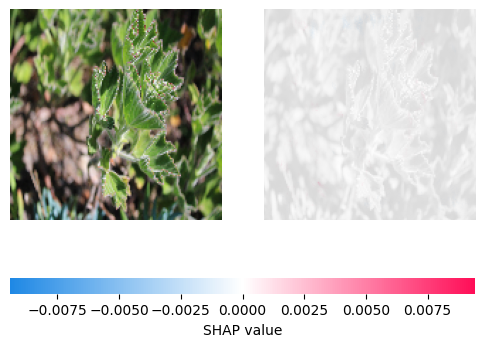

1/1 [==============================] - 0s 47ms/step


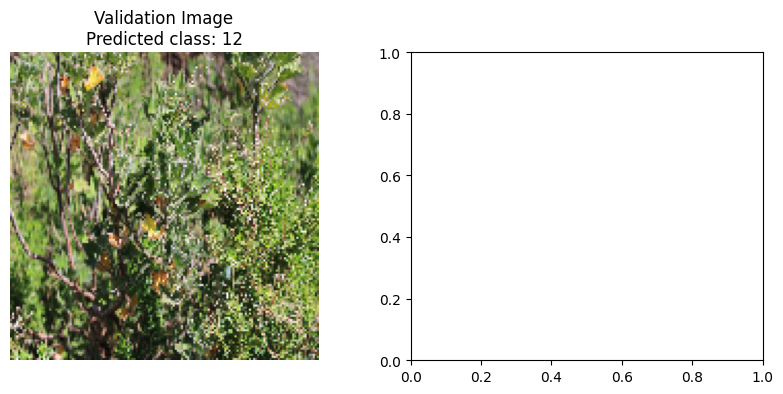

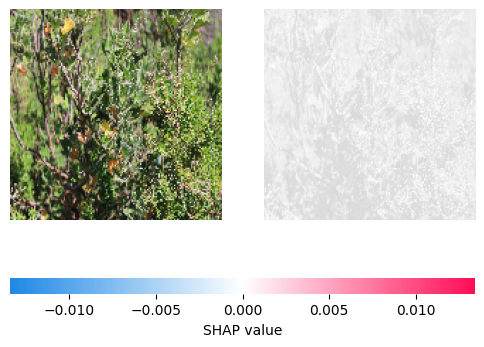

1/1 [==============================] - 0s 62ms/step


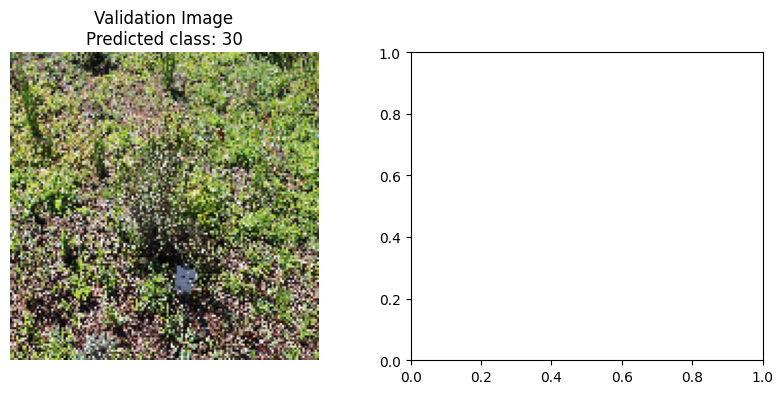

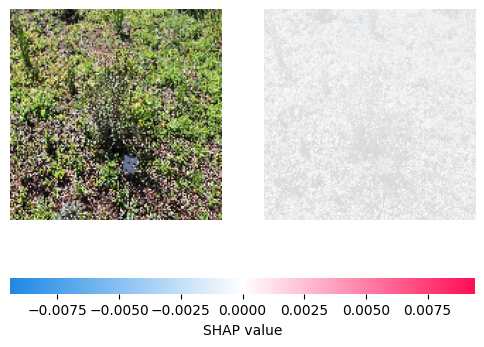

1/1 [==============================] - 0s 47ms/step


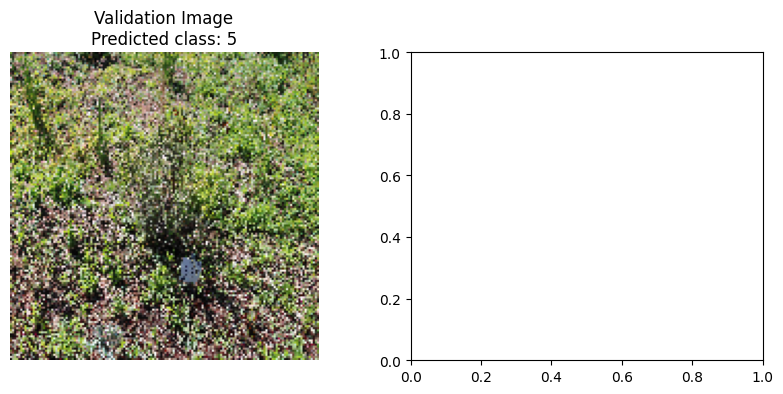

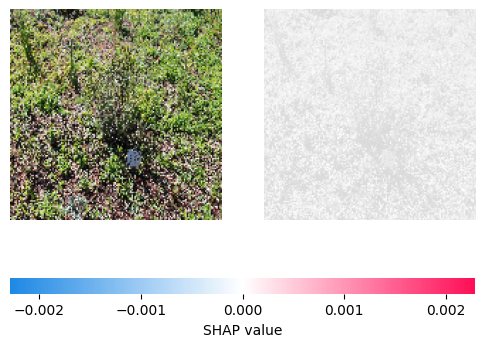

1/1 [==============================] - 0s 47ms/step


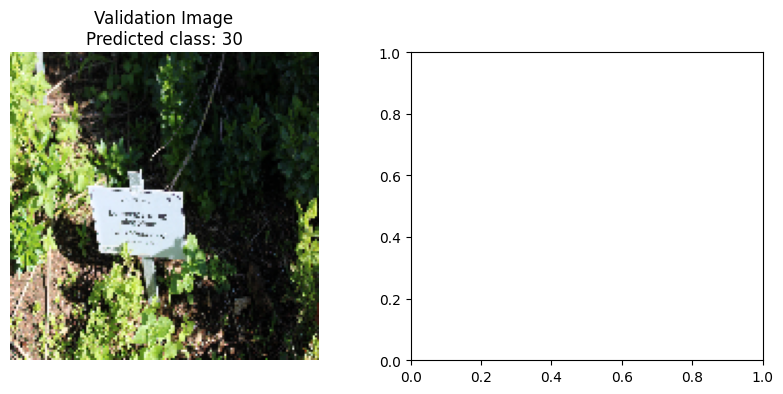

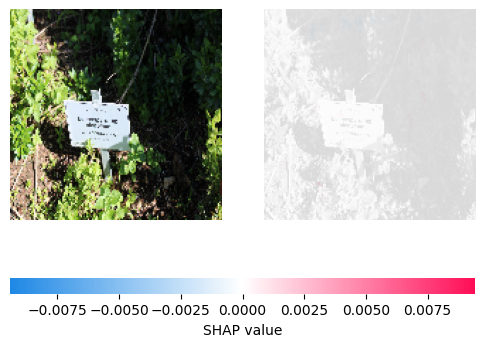

1/1 [==============================] - 0s 47ms/step


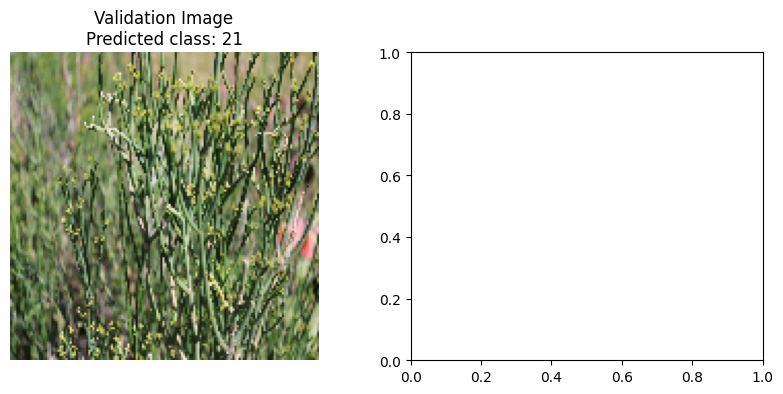

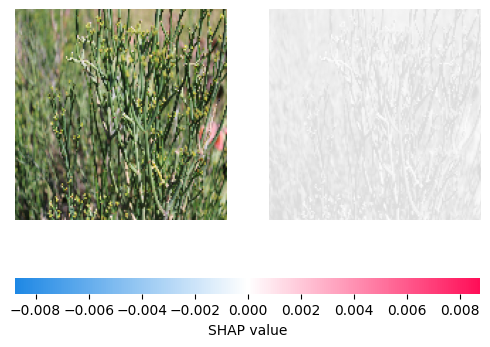

1/1 [==============================] - 0s 62ms/step


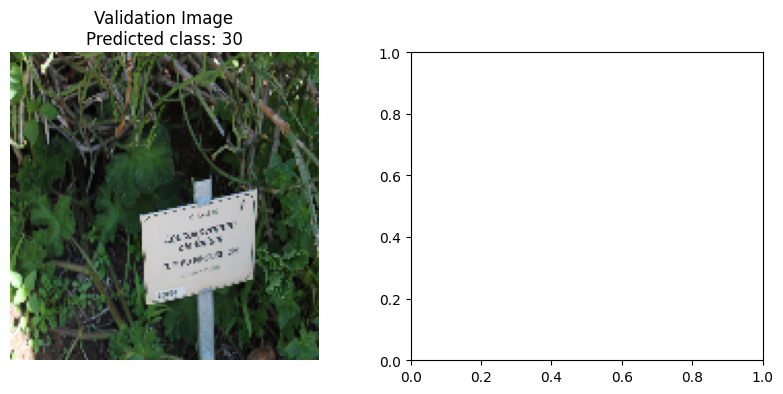

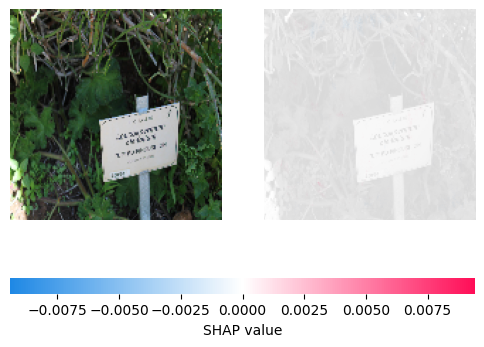

1/1 [==============================] - 0s 47ms/step


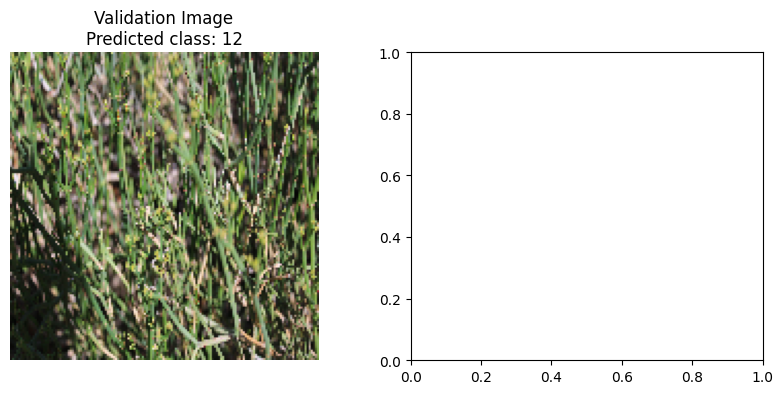

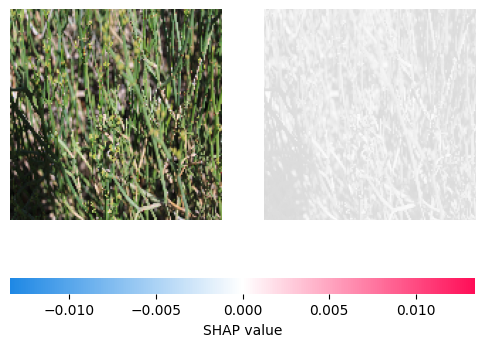

1/1 [==============================] - 0s 31ms/step


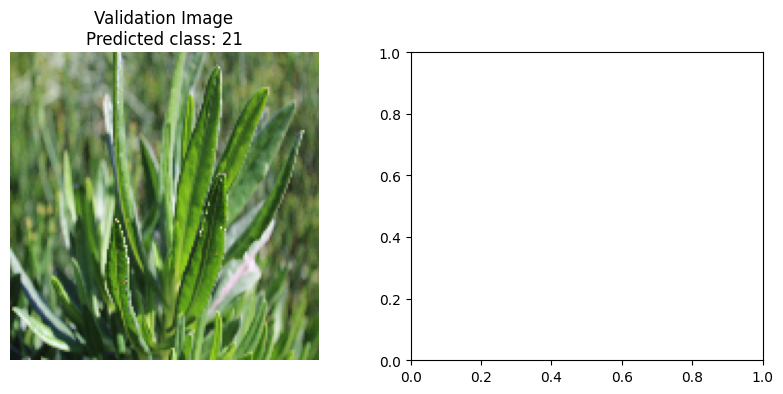

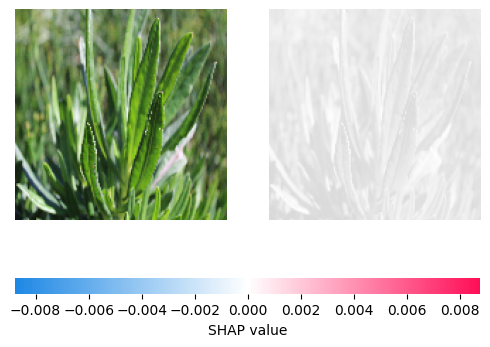

1/1 [==============================] - 0s 34ms/step


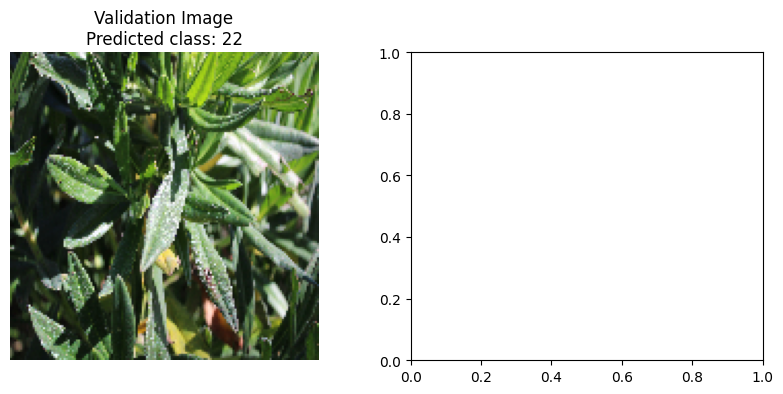

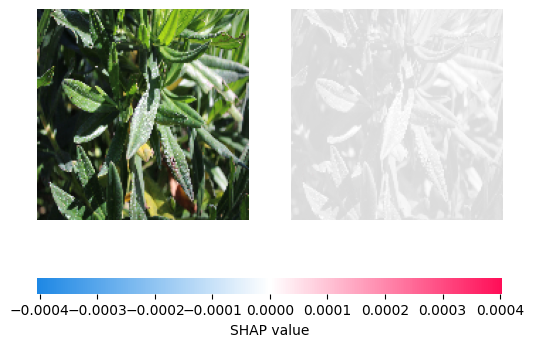

1/1 [==============================] - 0s 47ms/step


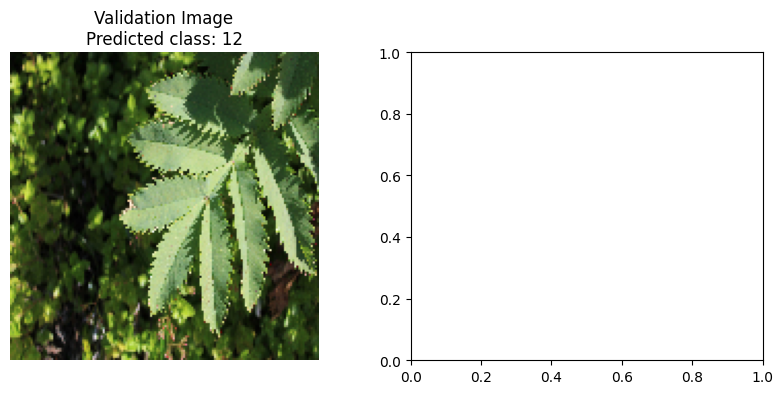

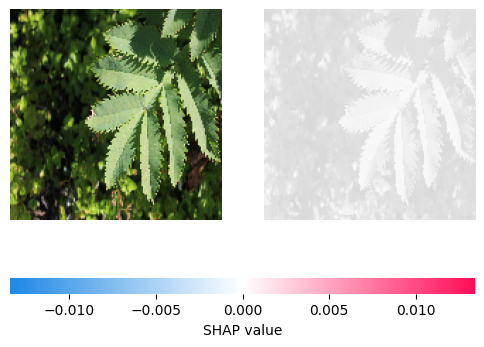

1/1 [==============================] - 0s 41ms/step


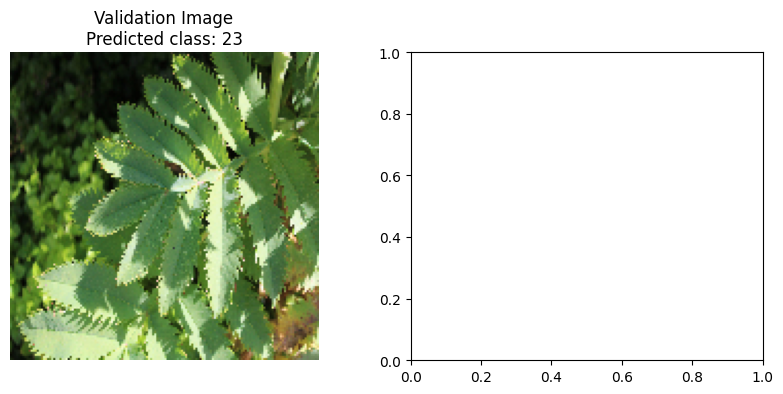

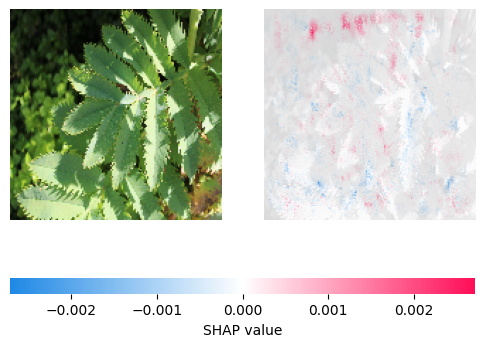

1/1 [==============================] - 0s 52ms/step


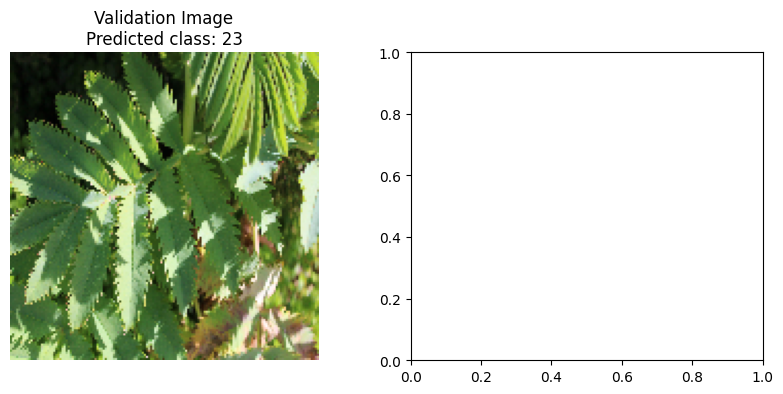

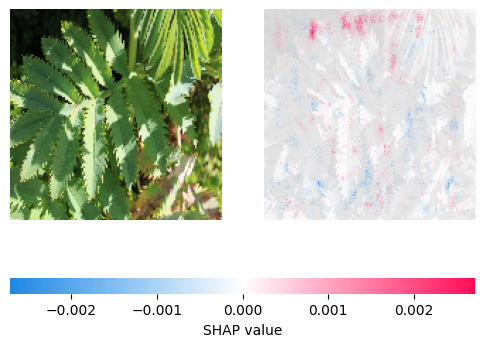

1/1 [==============================] - 0s 47ms/step


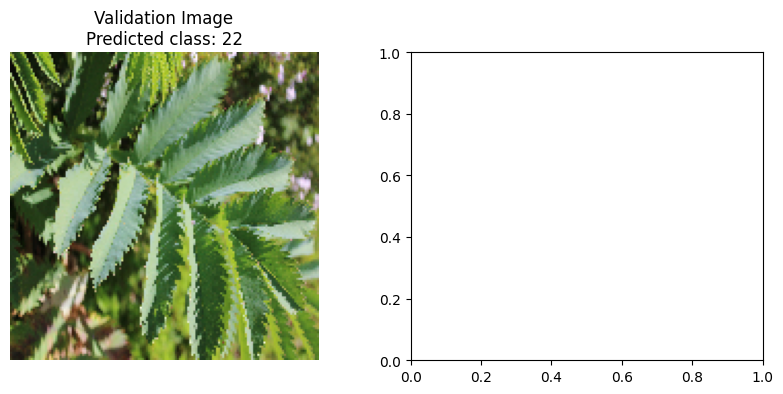

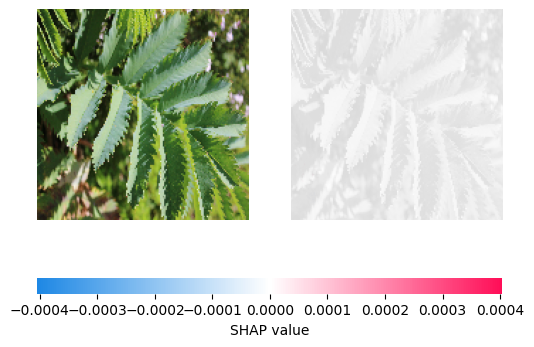

1/1 [==============================] - 0s 62ms/step


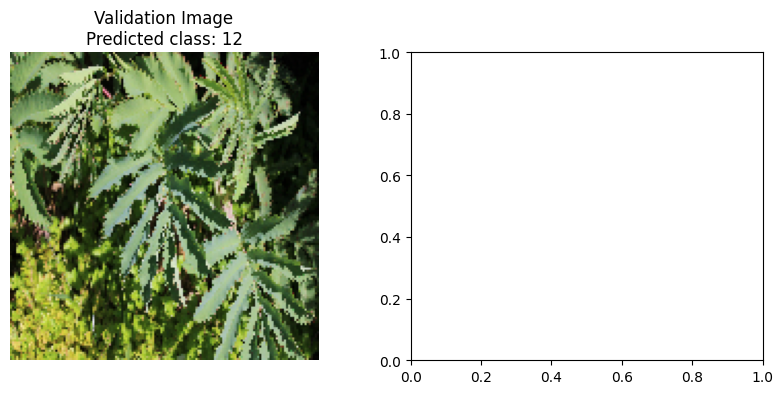

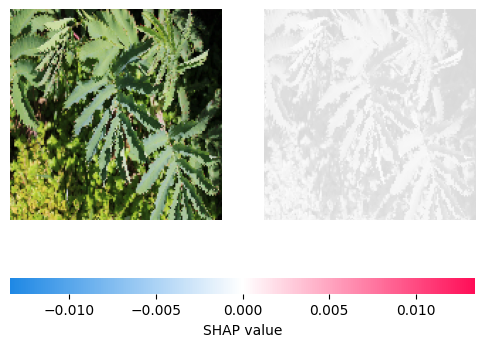

1/1 [==============================] - 0s 47ms/step


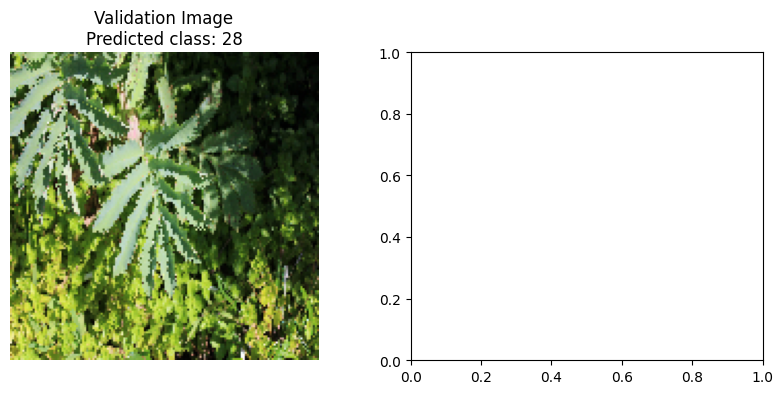

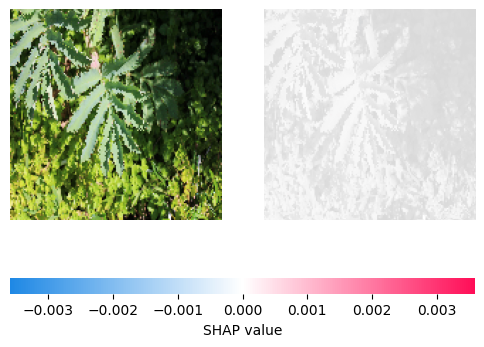

1/1 [==============================] - 0s 31ms/step


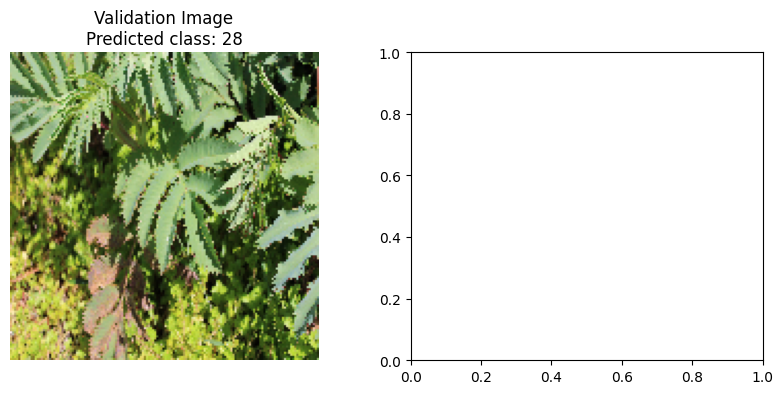

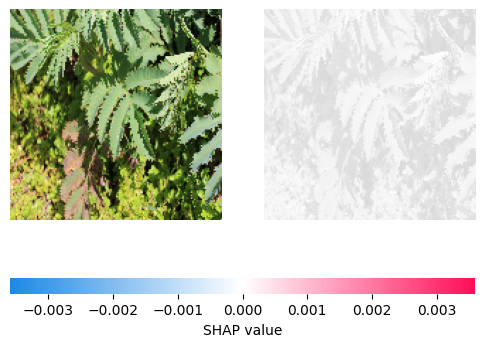

1/1 [==============================] - 0s 47ms/step


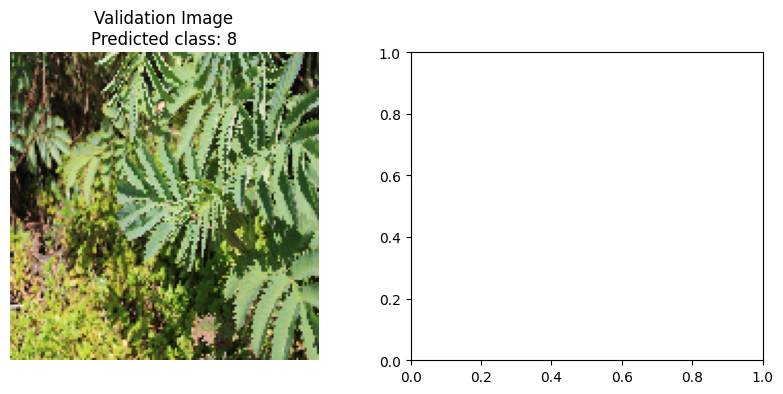

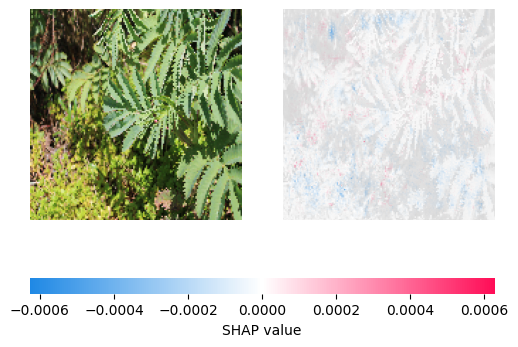

1/1 [==============================] - 0s 62ms/step


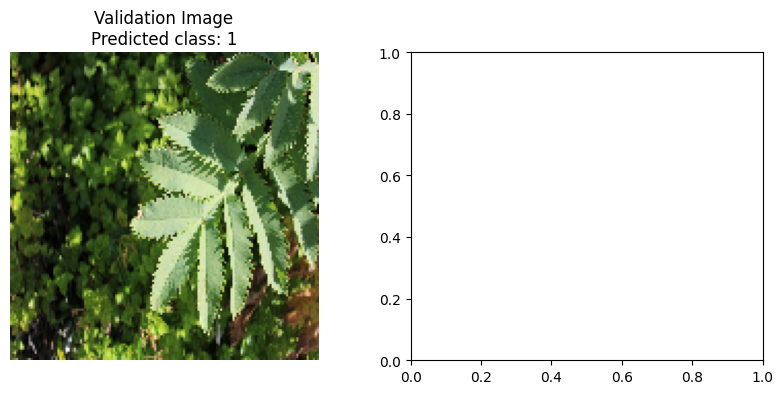

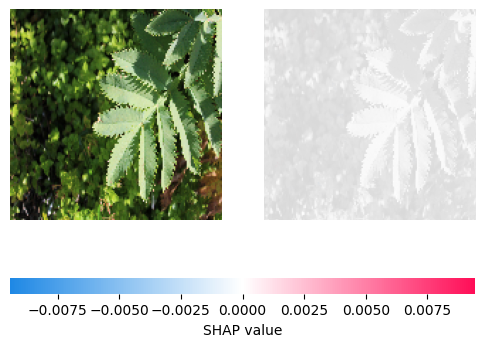

1/1 [==============================] - 0s 31ms/step


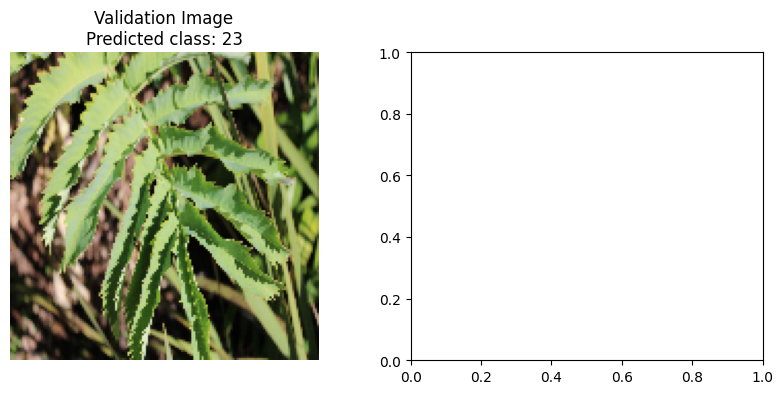

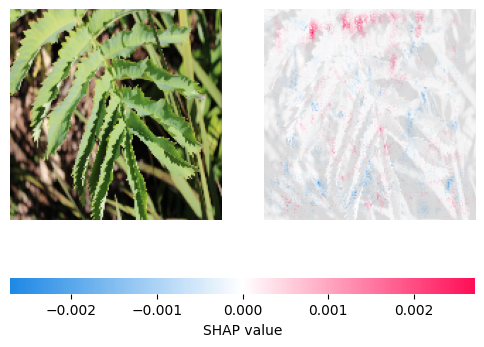

1/1 [==============================] - 0s 31ms/step


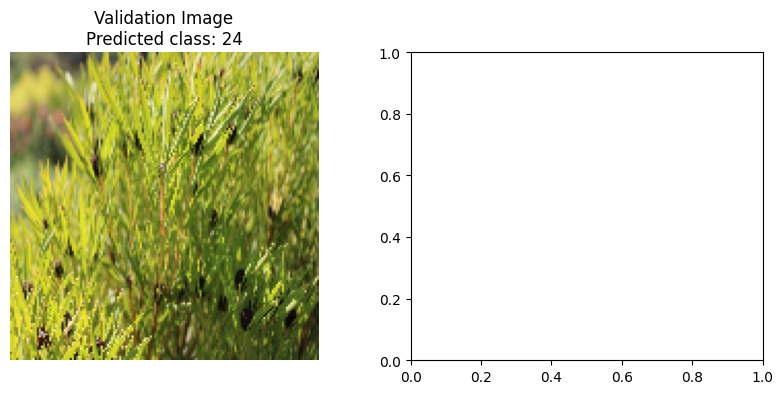

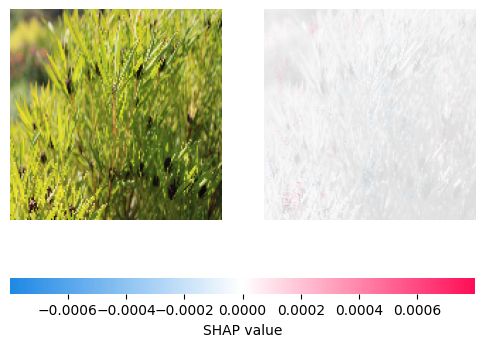

1/1 [==============================] - 0s 31ms/step


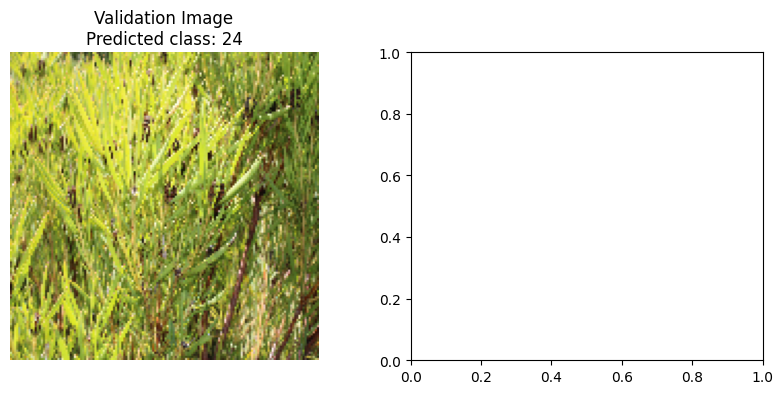

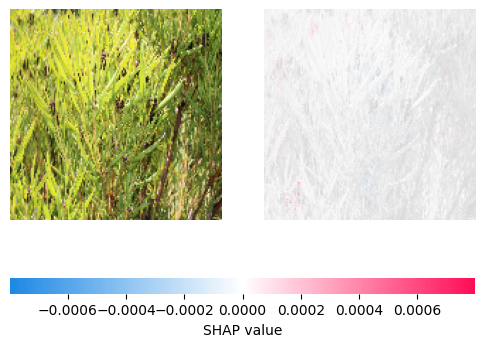

1/1 [==============================] - 0s 62ms/step


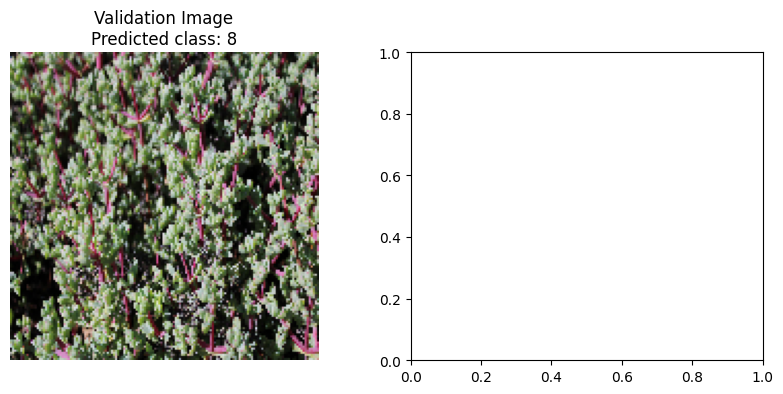

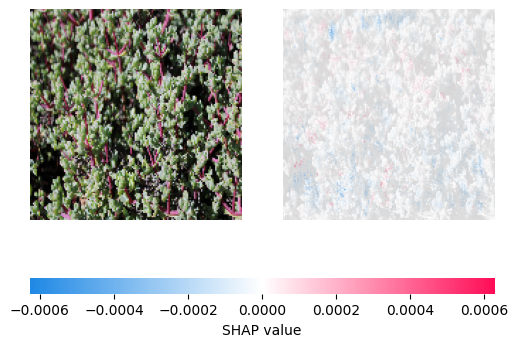

1/1 [==============================] - 0s 47ms/step


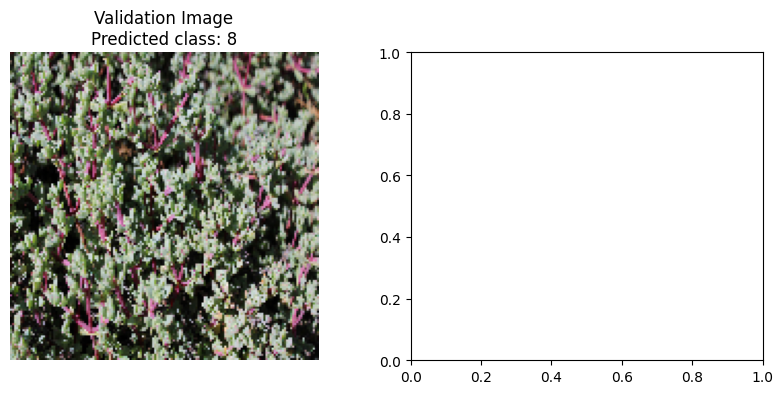

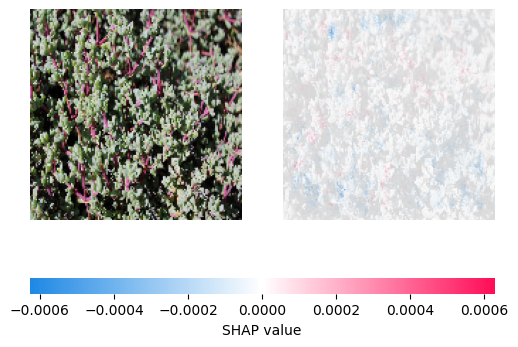

1/1 [==============================] - 0s 31ms/step


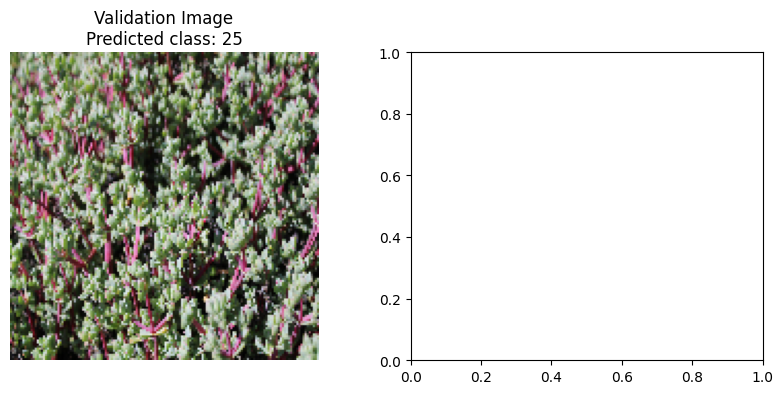

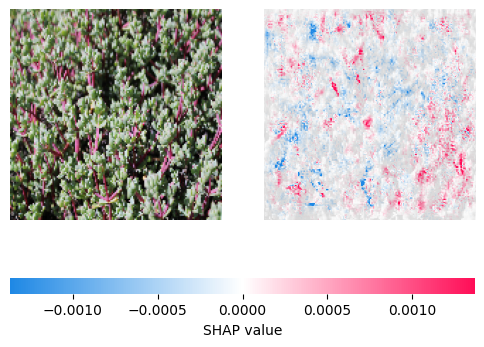

1/1 [==============================] - 0s 47ms/step


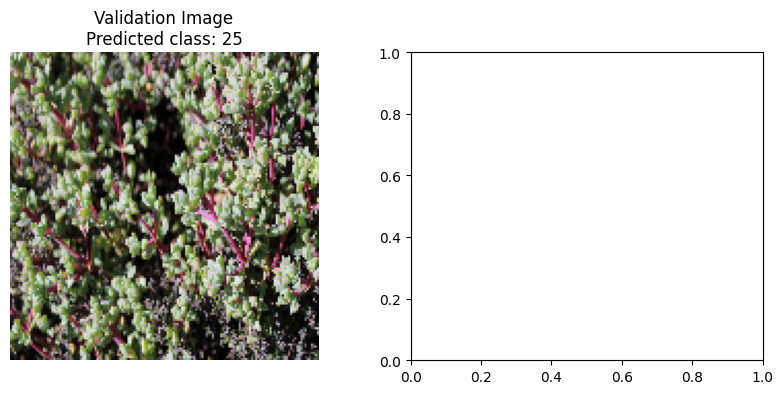

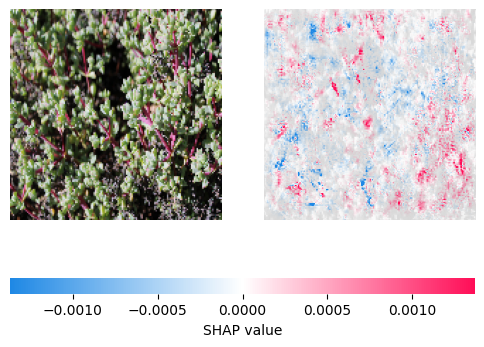

1/1 [==============================] - 0s 62ms/step


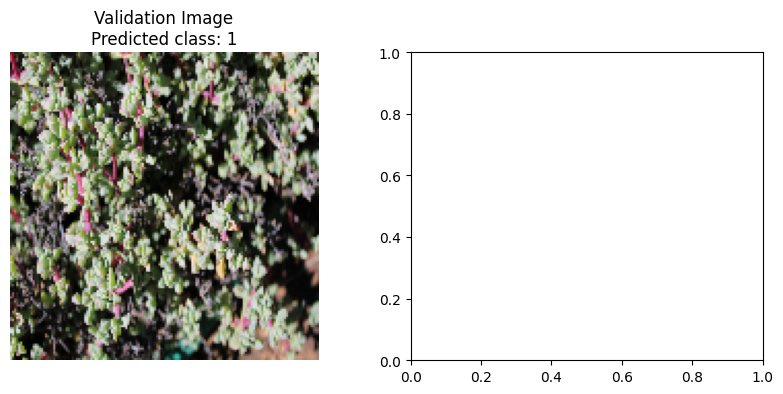

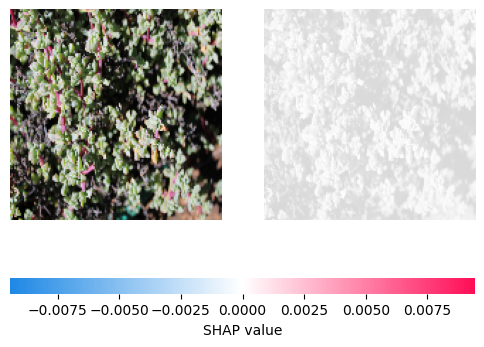

KeyboardInterrupt: 

In [223]:
import numpy as np
import matplotlib.pyplot as plt
import shap

# Assuming you have a validation_generator that yields batches of images
# and you have already created a SHAP explainer

# Iterate over the validation set
for images, _ in validation_generator:
    # Compute SHAP values for the batch
    shap_values = explainer.shap_values(images)

    # Plot SHAP values for each image in the batch
    for i in range(len(images)):
        image = images[i]
        predicted_class = np.argmax(model.predict(np.expand_dims(image, axis=0)))

        # Plotting
        fig, ax = plt.subplots(1, 2, figsize=(10, 4))

        # Original Image
        ax[0].imshow(image)
        ax[0].axis('off')
        ax[0].set_title(f"Validation Image\nPredicted class: {predicted_class}")

        # SHAP Values
        shap.image_plot(shap_values[predicted_class], np.expand_dims(image, axis=0))

        plt.show()

        # Optional: break or condition to limit the number of images processed


## More Dakka

1/1 [==============================] - 0s 125ms/step


<Figure size 640x480 with 0 Axes>

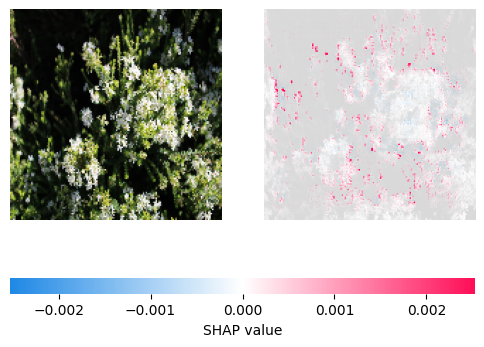

1/1 [==============================] - 0s 62ms/step


<Figure size 640x480 with 0 Axes>

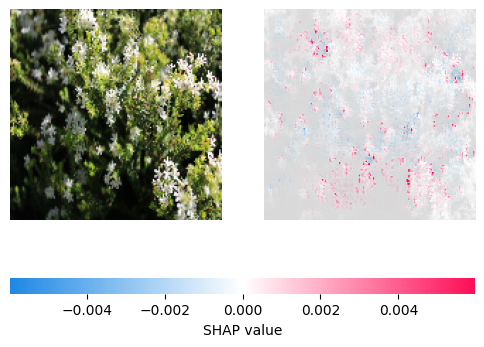

1/1 [==============================] - 0s 48ms/step


<Figure size 640x480 with 0 Axes>

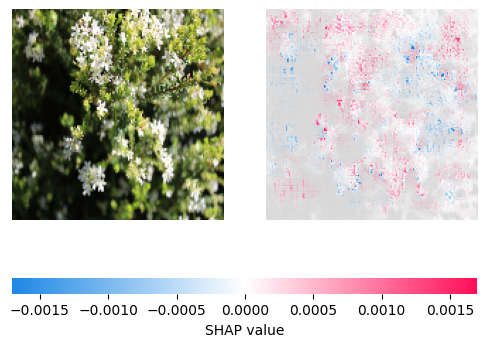

1/1 [==============================] - 0s 47ms/step


<Figure size 640x480 with 0 Axes>

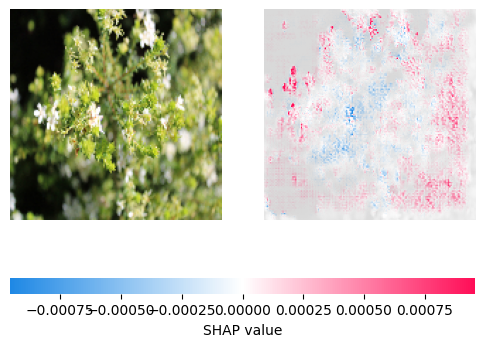

1/1 [==============================] - 0s 47ms/step


<Figure size 640x480 with 0 Axes>

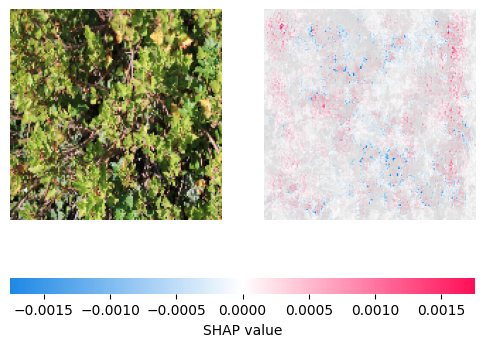

1/1 [==============================] - 0s 47ms/step


<Figure size 640x480 with 0 Axes>

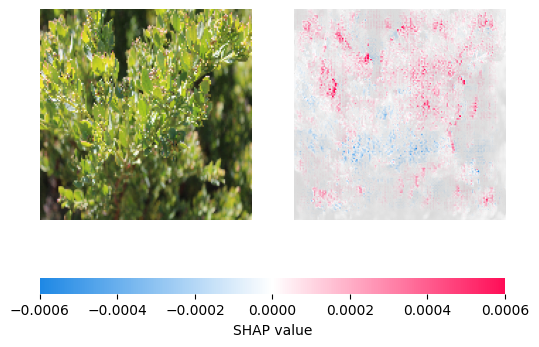

1/1 [==============================] - 0s 47ms/step


<Figure size 640x480 with 0 Axes>

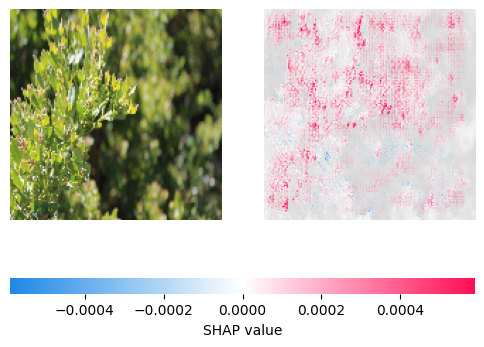

1/1 [==============================] - 0s 79ms/step


<Figure size 640x480 with 0 Axes>

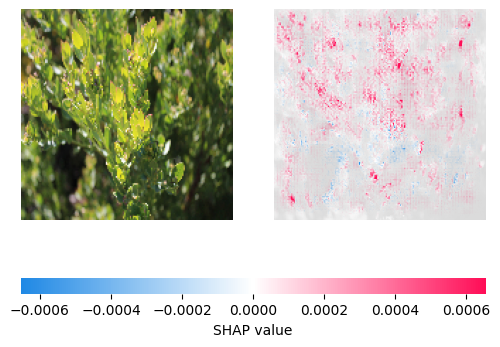

1/1 [==============================] - 0s 42ms/step


<Figure size 640x480 with 0 Axes>

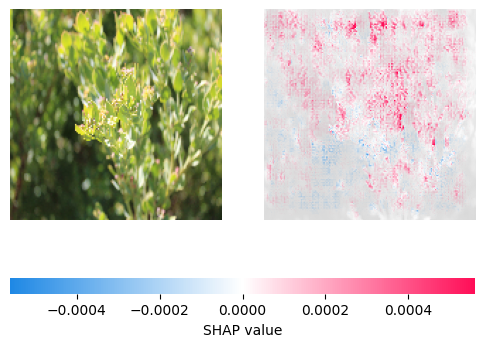

1/1 [==============================] - 0s 47ms/step


<Figure size 640x480 with 0 Axes>

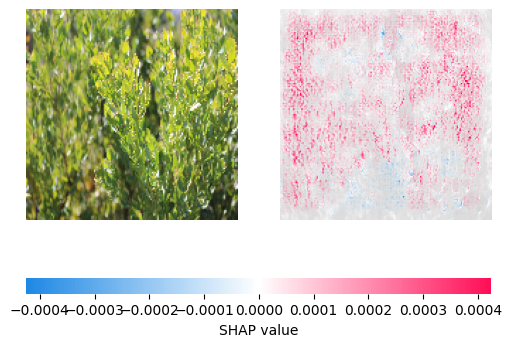

1/1 [==============================] - 0s 67ms/step


<Figure size 640x480 with 0 Axes>

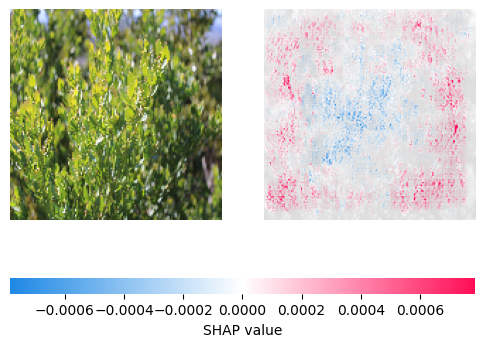

1/1 [==============================] - 0s 102ms/step


<Figure size 640x480 with 0 Axes>

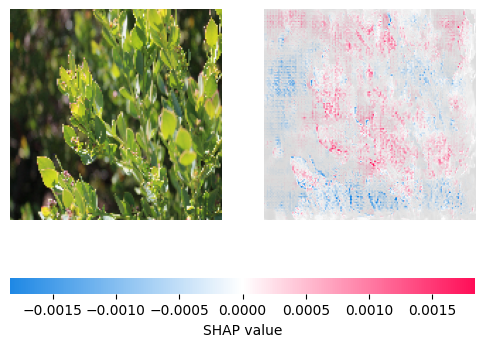

1/1 [==============================] - 0s 102ms/step


<Figure size 640x480 with 0 Axes>

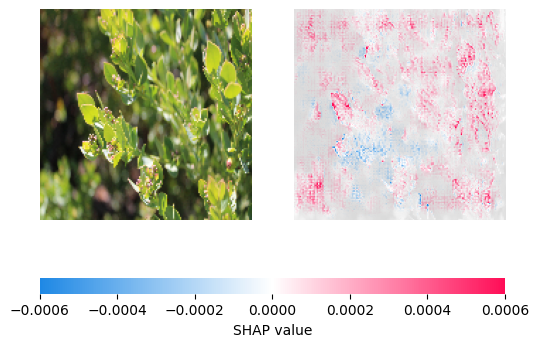

1/1 [==============================] - 0s 62ms/step


<Figure size 640x480 with 0 Axes>

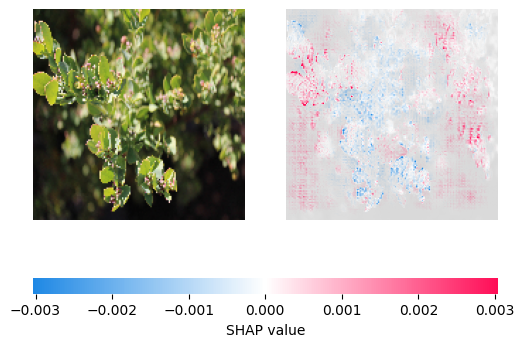

1/1 [==============================] - 0s 31ms/step


<Figure size 640x480 with 0 Axes>

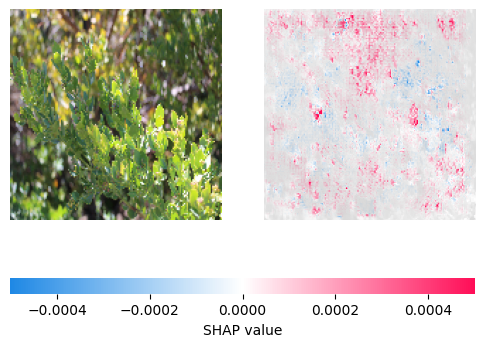

1/1 [==============================] - 0s 58ms/step


<Figure size 640x480 with 0 Axes>

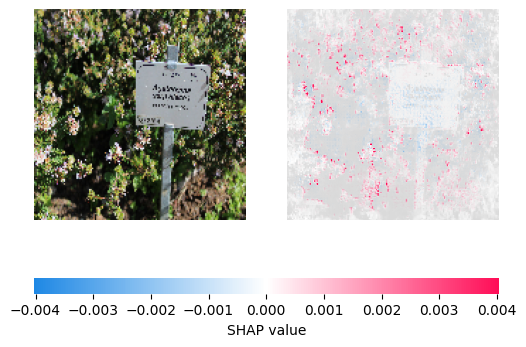

1/1 [==============================] - 0s 273ms/step


<Figure size 640x480 with 0 Axes>

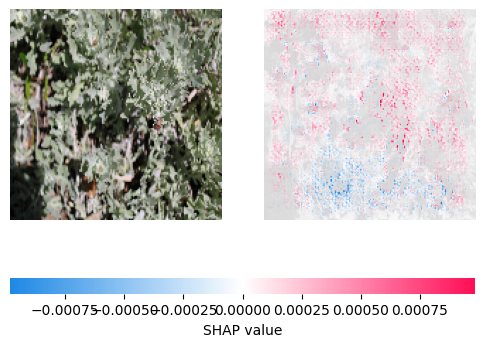

In [246]:
import os
import numpy as np
import matplotlib.pyplot as plt
import shap
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model

# Function to load and preprocess the image
def load_preprocess_image(img_path, target_size):
    img = load_img(img_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array /= 255.0  # Rescale the image
    return img_array

# Load your trained model


# Directory of the class you want to analyze
class_dir = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\Fynbos_Dataset_A\Agathosma serpyllacea" # Replace with your class directory

# Initialize SHAP DeepExplainer
explainer = shap.DeepExplainer(model, np.zeros((1, 150, 150, 3)))

# Iterate through each image in the specified class directory
for img_file in os.listdir(class_dir):
    if 'IMG' in img_file:
        img_path = os.path.join(class_dir, img_file)
        preprocessed_image = load_preprocess_image(img_path, (150, 150))

        # Predict the class of the image
        predictions = model.predict(preprocessed_image)
        predicted_class = np.argmax(predictions, axis=1)[0]

        # Compute SHAP values for the predicted class
        shap_values = explainer.shap_values(preprocessed_image)
        shap_values_for_predicted_class = shap_values[predicted_class][0]

        # Plot SHAP values
        plt.figure()
        shap.image_plot(shap_values_for_predicted_class, preprocessed_image[0])

        # Optionally, you can save these plots with a unique name for each
         #plt.savefig(f'shap_output_{img_file}.png')



In [259]:
import os
import numpy as np
import matplotlib.pyplot as plt
import shap
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model

# Function to load and preprocess the image
def load_preprocess_image(img_path, target_size):
    img = load_img(img_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array /= 255.0  # Rescale the image
    return img_array


# Directory of the class you want to analyze
class_dir = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\Fynbos_Dataset_A\Aloe arborescens"  # Replace with your class directory

# Directory to save the SHAP plots
save_dir = r"C:\Users\Jarushen\Desktop\Masters Thesis\Images\SHAP_Results\Baseline A"  # Replace with your desired save directory
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

# Initialize SHAP DeepExplainer
explainer = shap.DeepExplainer(model, np.zeros((1, 150, 150, 3)))

# Iterate through each image in the specified class directory
for img_file in os.listdir(class_dir):
    if 'IMG' in img_file:
        img_path = os.path.join(class_dir, img_file)
        preprocessed_image = load_preprocess_image(img_path, (150, 150))

        # Predict the class of the image
        predictions = model.predict(preprocessed_image)
        predicted_class = np.argmax(predictions, axis=1)[0]

        # Compute SHAP values for the predicted class
        shap_values = explainer.shap_values(preprocessed_image)
        shap_values_for_predicted_class = shap_values[predicted_class][0]

        # Plot SHAP values
        plt.figure()
        shap.image_plot(shap_values_for_predicted_class, preprocessed_image[0],show=False)

        # Save the plot in the specified directory
        plt.savefig(os.path.join(save_dir, f'shap_output_{img_file}_aloe_arborescens.png'))
        plt.close()  # Close the plot to free memory

print("All SHAP analysis plots saved.")



1/1 [==============================] - 0s 62ms/step
All SHAP analysis plots saved.


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
Leucadendron salignum, Erica cinerea, Erica discolor, Aloe arborescens, Aristea capitata

In [261]:
from sklearn.metrics import f1_score

# Evaluate the model on the validation set
val_loss, val_accuracy, val_top5_acc, val_top10_acc = model.evaluate(validation_generator)

# Get predictions and true labels from the validation set
y_pred = model.predict(validation_generator)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = validation_generator.classes

# Calculate F1 score for the validation set
f1 = f1_score(y_true, y_pred_classes, average='weighted')

# Prepare the data for the table
data = {
    "Metric": ["Accuracy", "F1 Score", "Loss", "Top 5 Accuracy", "Top 10 Accuracy"],
    "Value": [val_accuracy, f1, val_loss, val_top5_acc, val_top10_acc]
}

# Create DataFrame and display
results_table = pd.DataFrame(data)
print(results_table)

8/8 [==============================] - 99s 13s/step
            Metric     Value
0         Accuracy  0.337778
1         F1 Score  0.293444
2             Loss  3.178614
3   Top 5 Accuracy  0.617778
4  Top 10 Accuracy  0.786667
